(192, 263, 3)


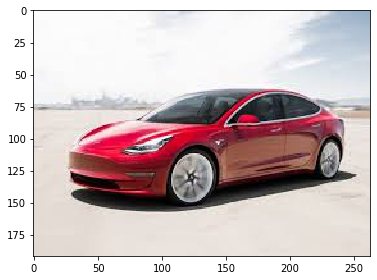

In [1]:
from skimage.io import imread, imshow
import matplotlib.pyplot as plt
%matplotlib inline

image_color = imread('car.jpeg', as_gray=False)
print(image_color.shape)
imshow(image_color)

# I. Data augmentation sequences for whole images

In [126]:
import numpy as np
import imgaug as ia
import imgaug.augmenters as iaa

ia.seed(1)

-1.6670036
141.02979


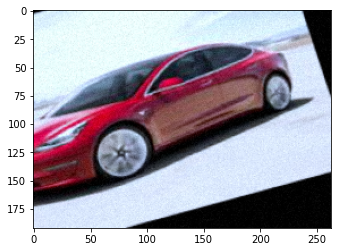

170.86992645263672
129.07745


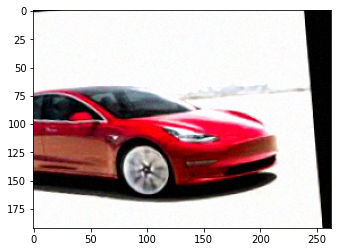

175.98175048828125
146.03218


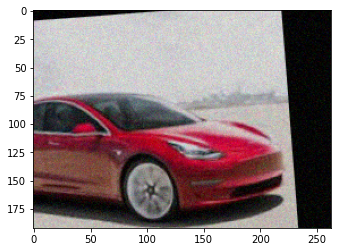

239.3574275970459
112.50664


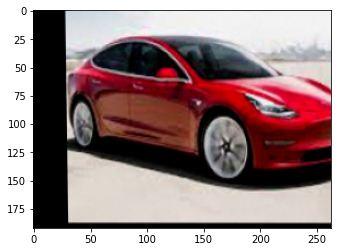

30.137497
119.42035


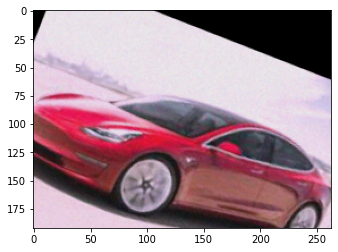

196.05388
156.67572


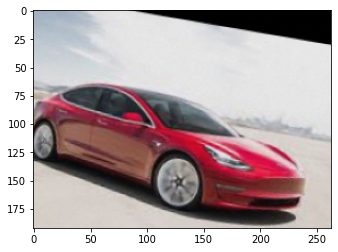

-9.538424
80.022125


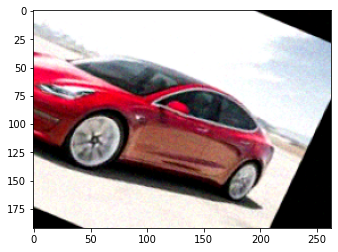

253.36865
113.94232


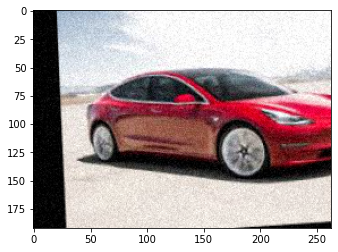

94.49855
114.94716


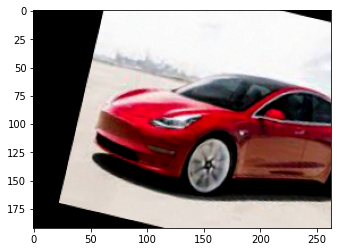

218.05704
154.90048


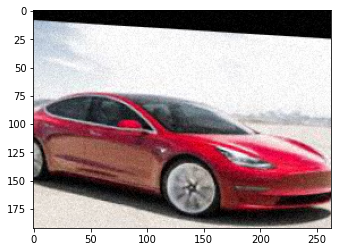

153.05957
138.2467


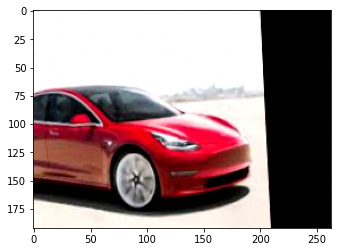

42.86586
123.823616


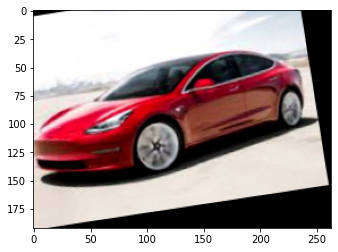

260.1872
98.36291


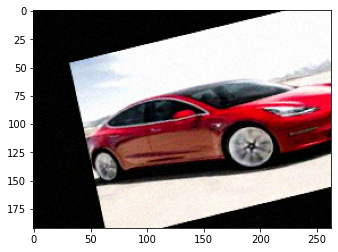

178.5804
107.40809


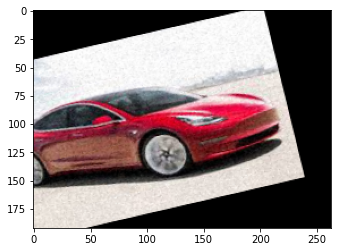

181.49933
111.22087


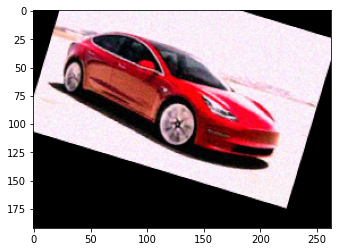

35.884663
109.69862


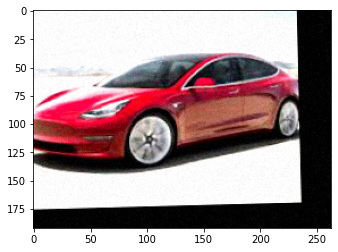

104.896355
121.402916


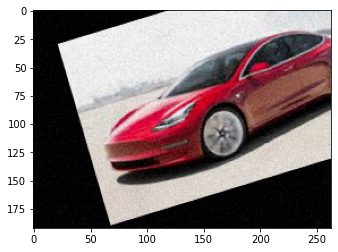

179.31949
141.2214


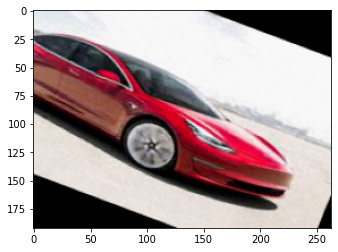

222.32182693481445
117.305855


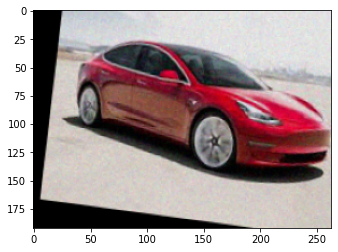

83.23298
119.98059


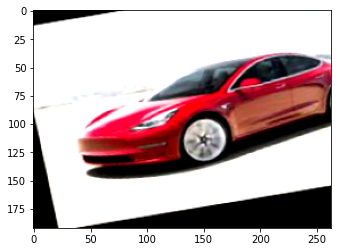

95.29584
102.4723


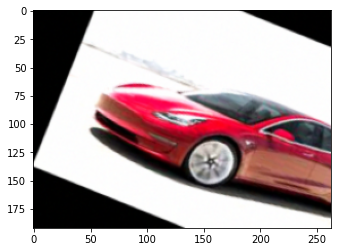

120.14595
98.78409


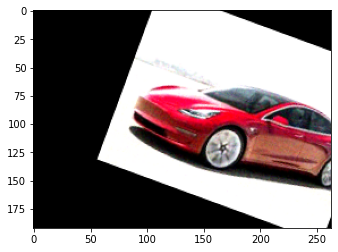

190.6874
177.6339


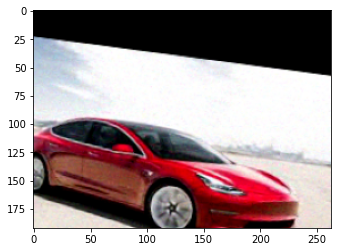

117.48695373535156
158.75583


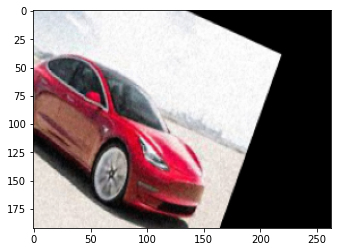

29.86696
116.70167


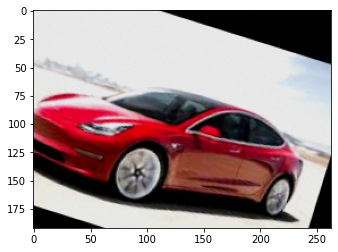

238.4569
114.987144


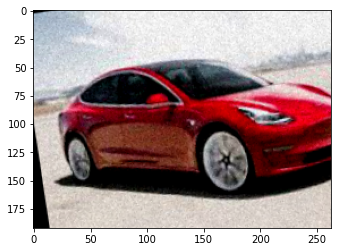

271.00262
117.675446


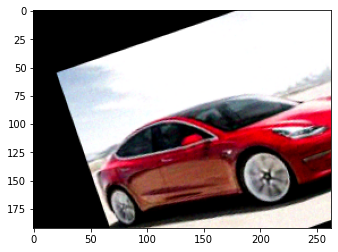

258.9820075035095
103.2108


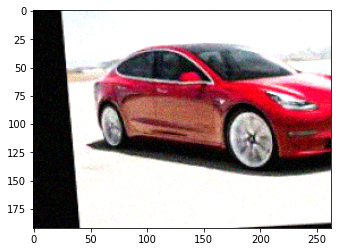

112.84993
117.5074


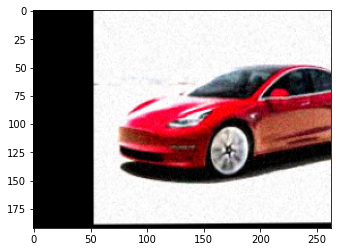

77.306046
151.13177


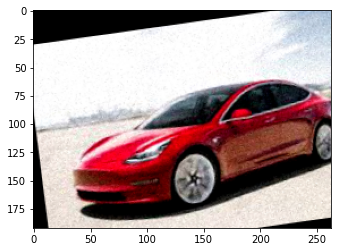

175.1711
117.17096


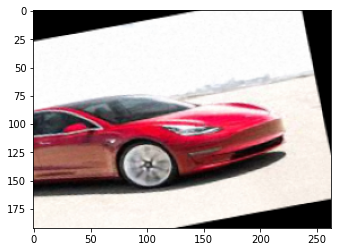

233.95583
91.14397


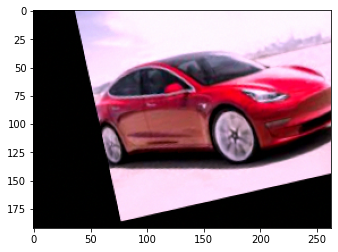

32


In [127]:
# Example batch of images.
# The array has shape (32, 64, 64, 3) and dtype uint8.
x_a = 65
y_a = 125
from imgaug.augmentables import Keypoint, KeypointsOnImage
kps_anchor = [Keypoint(x=x_a,y=y_a)]
kpsoi = KeypointsOnImage(kps_anchor,image_color.shape)
images = np.array(
    [image_color for _ in range(32)],
    dtype=np.uint8
)

seq = iaa.Sequential([
    iaa.Fliplr(0.5), # horizontal flips
    iaa.Crop(percent=(0, 0.1)), # random crops
    # Small gaussian blur with random sigma between 0 and 0.5.
    # But we only blur about 50% of all images.
    iaa.Sometimes(
        0.5,
        iaa.GaussianBlur(sigma=(0, 0.5))
    ),
    # Strengthen or weaken the contrast in each image.
    iaa.LinearContrast((0.75, 1.5)),
    # Add gaussian noise.
    # For 50% of all images, we sample the noise once per pixel.
    # For the other 50% of all images, we sample the noise per pixel AND
    # channel. This can change the color (not only brightness) of the
    # pixels.
    iaa.AdditiveGaussianNoise(loc=0, scale=(0.0, 0.05*255), per_channel=0.5),
    # Make some images brighter and some darker.
    # In 20% of all cases, we sample the multiplier once per channel,
    # which can end up changing the color of the images.
    iaa.Multiply((0.8, 1.2), per_channel=0.2),
    # Apply affine transformations to each image.
    # Scale/zoom them, translate/move them, rotate them and shear them.
    iaa.Affine(
        scale={"x": (0.8, 1.2), "y": (0.8, 1.2)},
        translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)},
        rotate=(-25, 25),
        shear=(-8, 8)
    )
], random_order=True) # apply augmenters in random order

images_aug = []
after_xs = []
after_ys = []
dict = {}
for i in range(32):
    image_aug, kpsoi_aug = seq(image=images[i], keypoints=kps_anchor)
    kpsoi_aug2 = KeypointsOnImage(kpsoi_aug,image_aug.shape)
    kpsoi_aug_pos_img = kpsoi_aug2.draw_on_image(image_aug, size=5)
    before = kpsoi.keypoints[0]
    after = kpsoi_aug2.keypoints[0]
    after_x = after.x
    after_y = after.y
    print(after_x)
    print(after_y)
    after_xs.append(after.x)
    after_ys.append(after.y)
    images_aug.append(image_aug)
    plt.imshow(image_aug)
    plt.show()
print(len(images_aug))

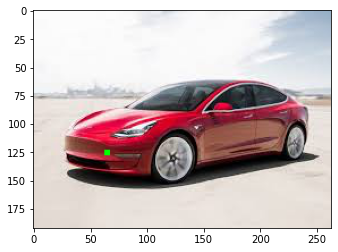

In [147]:
kpsoi_img = kpsoi.draw_on_image(image_color, size=5)
plt.imshow(kpsoi_img)
plt.show()

In [148]:
print(after_xs)
print(len(after_xs))
print(after_ys)
print(len(after_ys))

[-1.6670036, 170.86992645263672, 175.98175048828125, 239.3574275970459, 30.137497, 196.05388, -9.538424, 253.36865, 94.49855, 218.05704, 153.05957, 42.86586, 260.1872, 178.5804, 181.49933, 35.884663, 104.896355, 179.31949, 222.32182693481445, 83.23298, 95.29584, 120.14595, 190.6874, 117.48695373535156, 29.86696, 238.4569, 271.00262, 258.9820075035095, 112.84993, 77.306046, 175.1711, 233.95583]
32
[141.02979, 129.07745, 146.03218, 112.50664, 119.42035, 156.67572, 80.022125, 113.94232, 114.94716, 154.90048, 138.2467, 123.823616, 98.36291, 107.40809, 111.22087, 109.69862, 121.402916, 141.2214, 117.305855, 119.98059, 102.4723, 98.78409, 177.6339, 158.75583, 116.70167, 114.987144, 117.675446, 103.2108, 117.5074, 151.13177, 117.17096, 91.14397]
32


(192, 263, 3)


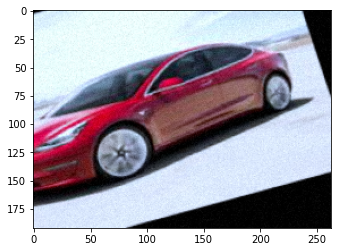

In [131]:
aug_img = images_aug[0]
print(aug_img.shape)
plt.imshow(aug_img)
plt.show()

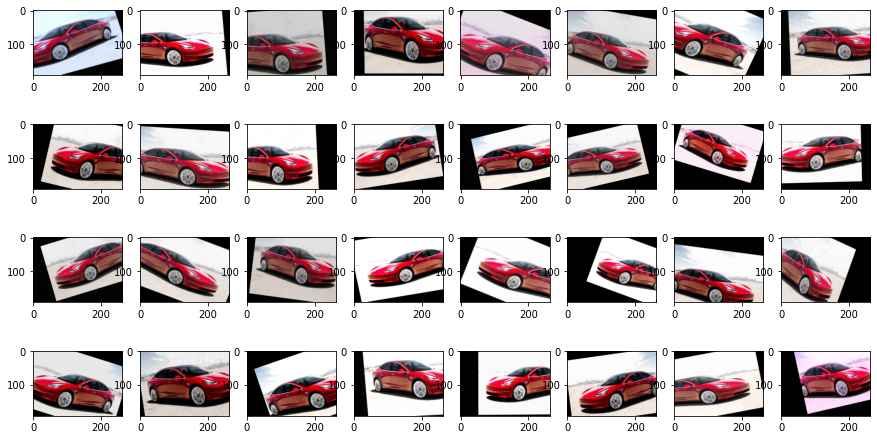

In [132]:
fig = plt.figure(figsize=(15,8))
for i in range(1,33):
    aug_img = images_aug[i-1]
    fig.add_subplot(4,8,i)
    plt.imshow(aug_img)
plt.show()

# II. Choose the positive and negative pairs 
## 20 positive item & 12 negative item. Keep the new center anchor candidates in lists.

In [133]:
import random
pos_num = 20
positives = random.sample(range(32),pos_num)
negatives = []
for i in range(32):
    if i not in positives:
        negatives.append(i)
print('The indexes of positive {} images'.format(pos_num))
print(positives)
print('The indexes of negative {} images'.format(32-pos_num))
print(negatives)

The indexes of positive 20 images
[9, 26, 31, 4, 8, 29, 1, 23, 27, 6, 21, 13, 10, 7, 0, 15, 2, 28, 22, 14]
The indexes of negative 12 images
[3, 5, 11, 12, 16, 17, 18, 19, 20, 24, 25, 30]


In [136]:
pos_images = []
neg_images = []
pos_after_xs = []
pos_after_ys = []
neg_after_xs = []
neg_after_ys = []
for i in positives:
    pos_images.append(images_aug[i])
    pos_after_xs.append(after_xs[i])
    pos_after_ys.append(after_ys[i])
for j in negatives:
    neg_images.append(images_aug[j])
    neg_after_xs.append(after_xs[j])
    neg_after_ys.append(after_ys[j])
#print(pos_images)
#print(neg_images)
print(len(pos_images))
print(len(neg_images))
#print(pos_images[0])
print(pos_images[1].shape)
print(pos_after_xs)
print(pos_after_ys)
print(neg_after_xs)
print(neg_after_ys)

20
12
(192, 263, 3)
[218.05704, 271.00262, 233.95583, 30.137497, 94.49855, 77.306046, 170.86992645263672, 117.48695373535156, 258.9820075035095, -9.538424, 120.14595, 178.5804, 153.05957, 253.36865, -1.6670036, 35.884663, 175.98175048828125, 112.84993, 190.6874, 181.49933]
[154.90048, 117.675446, 91.14397, 119.42035, 114.94716, 151.13177, 129.07745, 158.75583, 103.2108, 80.022125, 98.78409, 107.40809, 138.2467, 113.94232, 141.02979, 109.69862, 146.03218, 117.5074, 177.6339, 111.22087]
[239.3574275970459, 196.05388, 42.86586, 260.1872, 104.896355, 179.31949, 222.32182693481445, 83.23298, 95.29584, 29.86696, 238.4569, 175.1711]
[112.50664, 156.67572, 123.823616, 98.36291, 121.402916, 141.2214, 117.305855, 119.98059, 102.4723, 116.70167, 114.987144, 117.17096]


## <1>Show the positive ones with patches

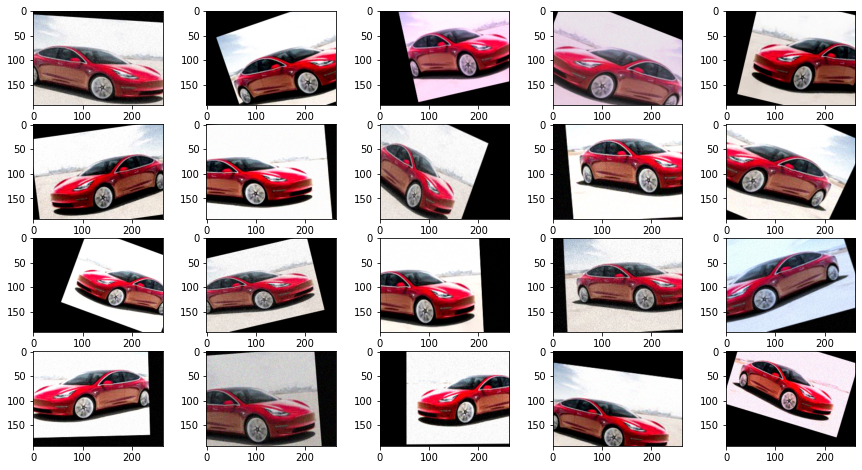

In [137]:
fig = plt.figure(figsize=(15,8))
for i in range(1,21):
    pos_img = pos_images[i-1]
    fig.add_subplot(4,5,i)
    plt.imshow(pos_img)
plt.show()

218.05704
154.90048
The 0 positive image


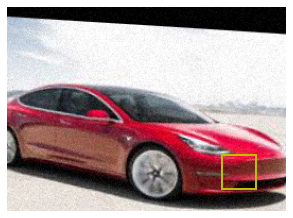

271.00262
117.675446
The 1 positive image


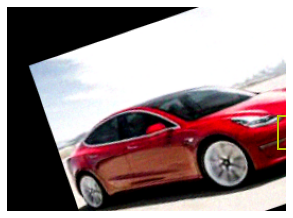

233.95583
91.14397
The 2 positive image


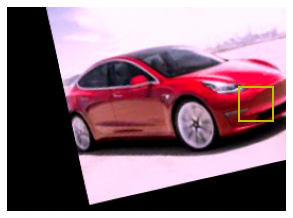

30.137497
119.42035
The 3 positive image


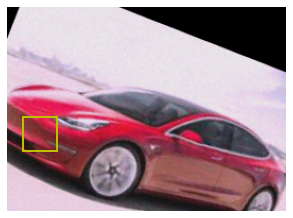

94.49855
114.94716
The 4 positive image


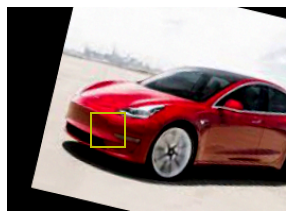

77.306046
151.13177
The 5 positive image


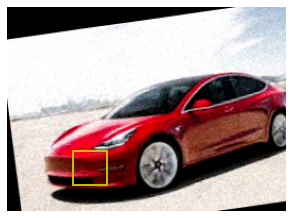

170.86992645263672
129.07745
The 6 positive image


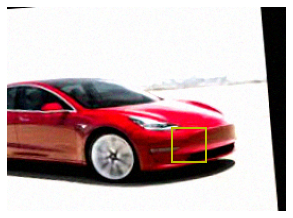

117.48695373535156
158.75583
The 7 positive image


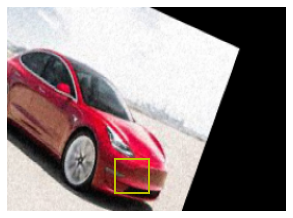

258.9820075035095
103.2108
The 8 positive image


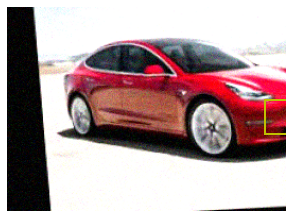

-9.538424
80.022125
The 9 positive image


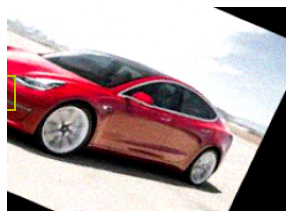

120.14595
98.78409
The 10 positive image


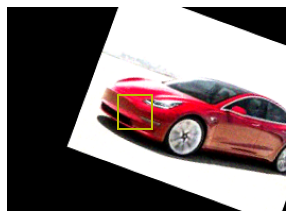

178.5804
107.40809
The 11 positive image


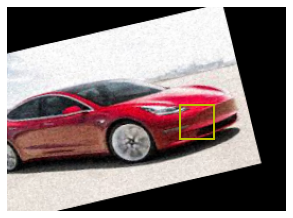

153.05957
138.2467
The 12 positive image


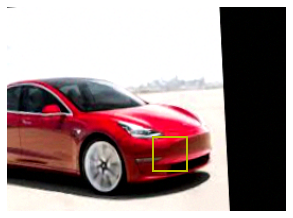

253.36865
113.94232
The 13 positive image


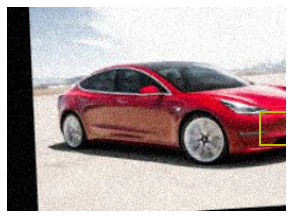

-1.6670036
141.02979
The 14 positive image


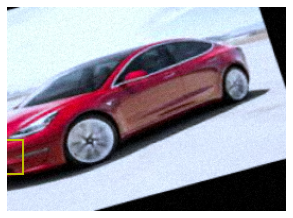

35.884663
109.69862
The 15 positive image


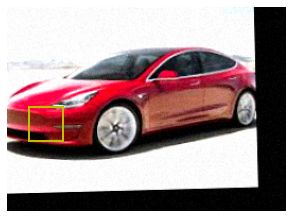

175.98175048828125
146.03218
The 16 positive image


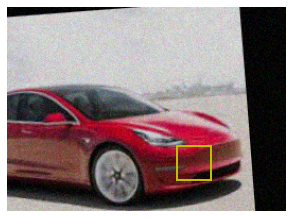

112.84993
117.5074
The 17 positive image


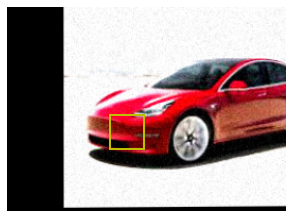

190.6874
177.6339
The 18 positive image


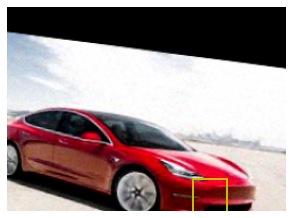

181.49933
111.22087
The 19 positive image


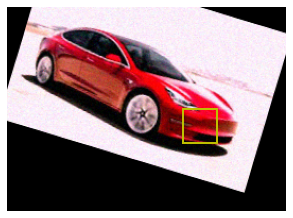

In [155]:
for i in range(20):
    fig,ax = plt.subplots(figsize=(5,8))
    x_c = pos_after_xs[i]
    y_c = pos_after_ys[i]
    print(x_c)
    print(y_c)
    print('The {} positive image'.format(i))
    ax.imshow(pos_images[i])
    aug_pos_pat = ax.add_patch(Rectangle((x_c-16,y_c-16),32,32,fc='none',ec='y',lw=2))
    ax.axis('off')
    plt.show()

## check if the patch has been out of range

In [163]:
def check(image_aug, x_c, y_c):
    height, width, _ = image_aug.shape
    #print(height)
    #print(width)
    if x_c-16<0 or x_c+16>width or y_c-16<0 or y_c+16>height:
        #print('The augmentation patch has been out of range!')
        return 0
    else:
        #print('OKK')
        return 1
i_out = []
for i in range(20):
    image_aug = pos_images[i]
    x_c = pos_after_xs[i]
    y_c = pos_after_ys[i]
    #print(x_c)
    #print(y_c)
    print('The {} positive image'.format(i))
    check(image_aug, x_c, y_c)
    if check(image_aug, x_c, y_c)!=1:
        print('The augmentation patch has been out of range!')
        j = i
        i_out.append(j)
    else:
        print('OKK')
print('The out of range image indexes')
print(i_out)

The 0 positive image
OKK
The 1 positive image
The augmentation patch has been out of range!
The 2 positive image
OKK
The 3 positive image
OKK
The 4 positive image
OKK
The 5 positive image
OKK
The 6 positive image
OKK
The 7 positive image
OKK
The 8 positive image
The augmentation patch has been out of range!
The 9 positive image
The augmentation patch has been out of range!
The 10 positive image
OKK
The 11 positive image
OKK
The 12 positive image
OKK
The 13 positive image
The augmentation patch has been out of range!
The 14 positive image
The augmentation patch has been out of range!
The 15 positive image
OKK
The 16 positive image
OKK
The 17 positive image
OKK
The 18 positive image
The augmentation patch has been out of range!
The 19 positive image
OKK
The out of range image indexes
[1, 8, 9, 13, 14, 18]


## 1.First way to have the mask.

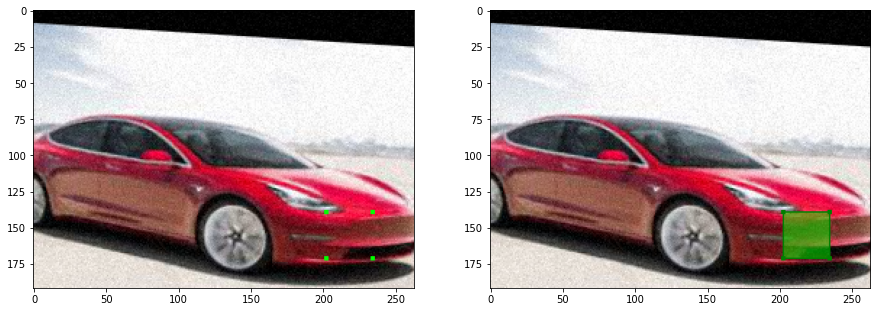

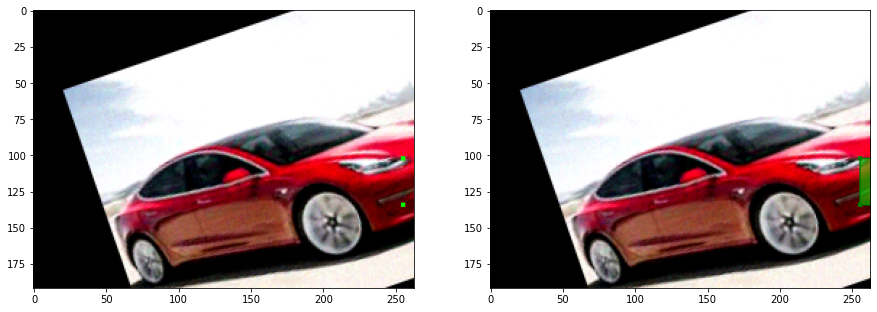

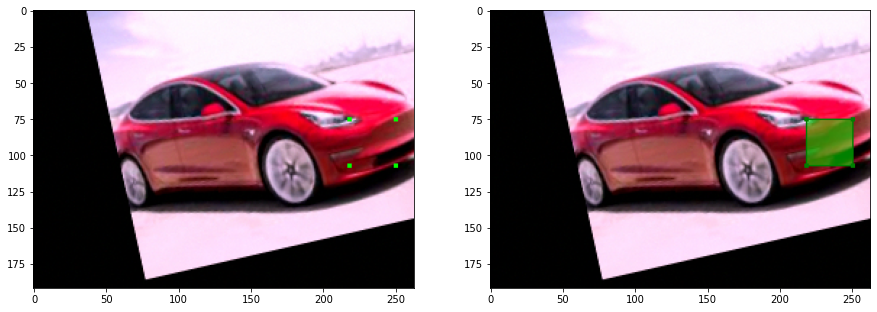

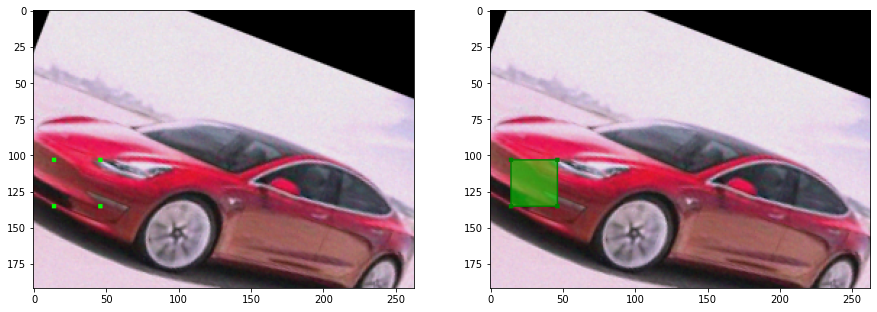

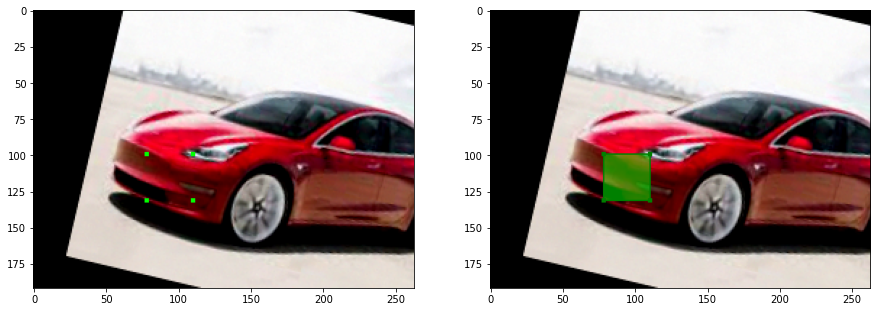

...

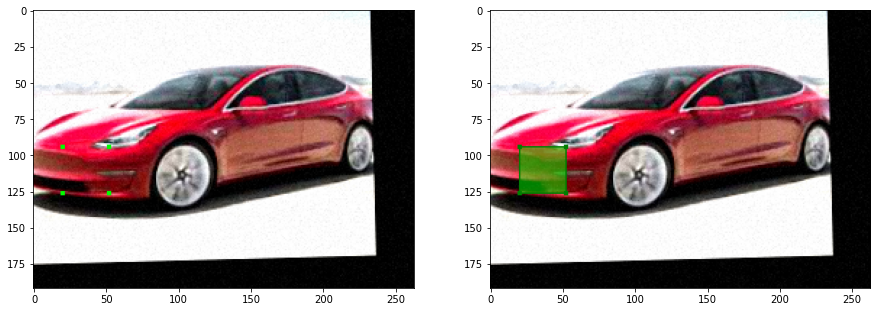

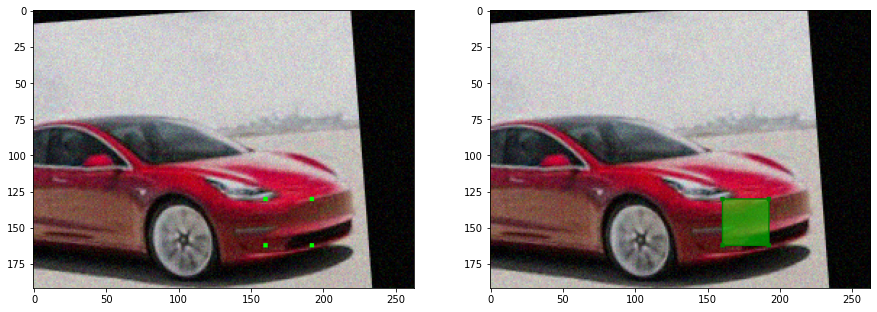

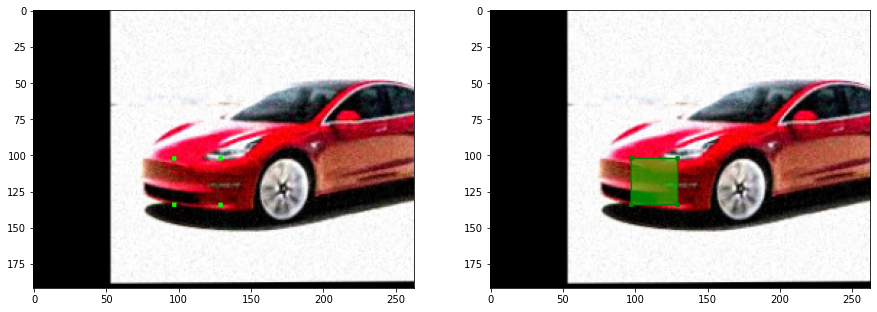

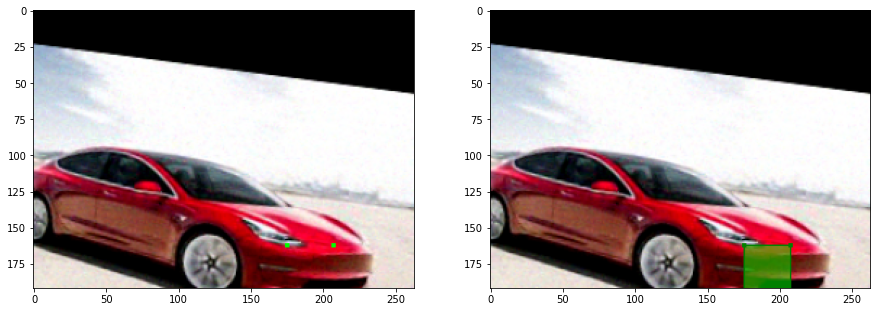

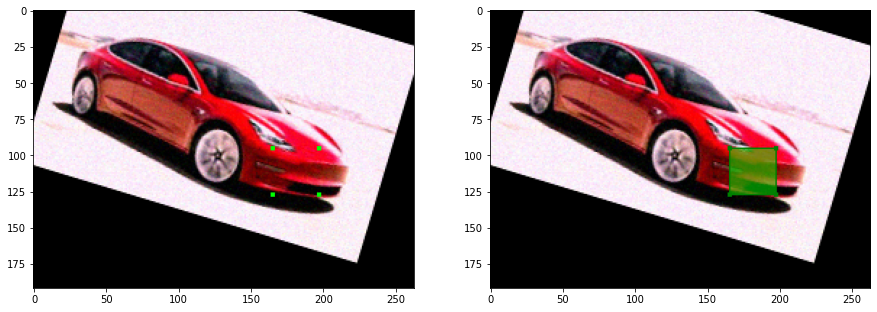

In [174]:
for i in range(20):
    fig,ax = plt.subplots(figsize=(15,8))
    image_aug = pos_images[i]
    x_c = pos_after_xs[i]
    y_c = pos_after_ys[i]
    chipmunk_kps_xy = np.float32([
    [x_c-16, y_c-16],
    [x_c-16, y_c+16],
    [x_c+16, y_c+16],
    [x_c+16, y_c-16],])
    kpsoi_chipmunk = KeypointsOnImage.from_xy_array(chipmunk_kps_xy, shape=image_aug.shape)
    kpsoi_box_anchor_img = kpsoi_chipmunk.draw_on_image(image_aug, size=3)
    from imgaug.augmentables.polys import Polygon
    poly_chipmunk = Polygon(kpsoi_chipmunk.keypoints)
    poly_img = poly_chipmunk.draw_on_image(image_aug)
    #plt.figure(figsize=(15,8))
    plt.subplot(121)
    plt.imshow(kpsoi_box_anchor_img)
    plt.subplot(122)
    plt.imshow(poly_img)
    plt.show()

## 2.Second way to have the mask.

218.05704
154.90048


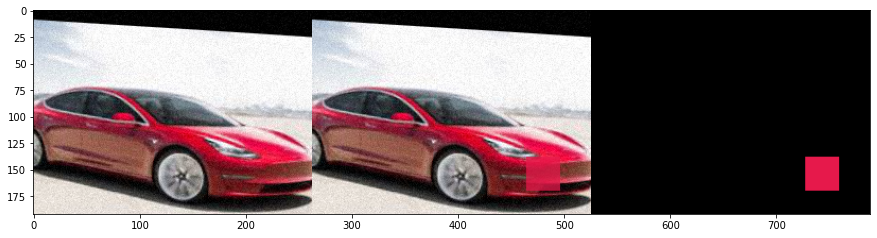

271.00262
117.675446


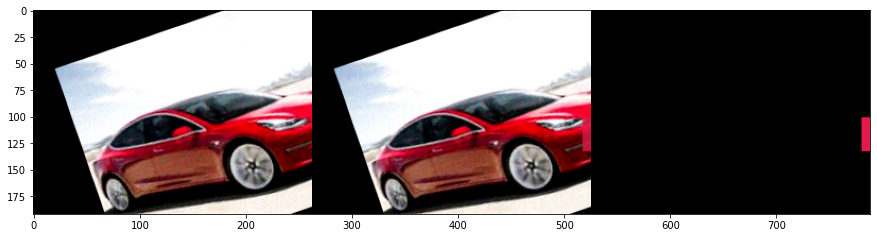

233.95583
91.14397


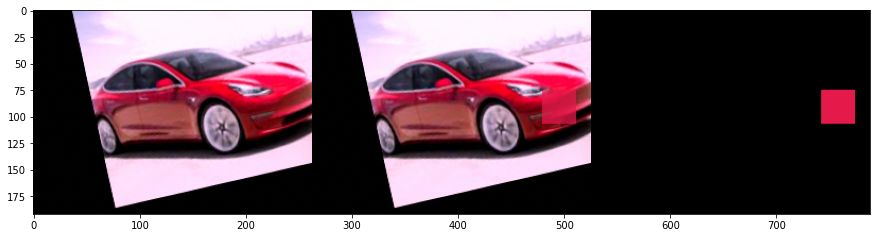

30.137497
119.42035


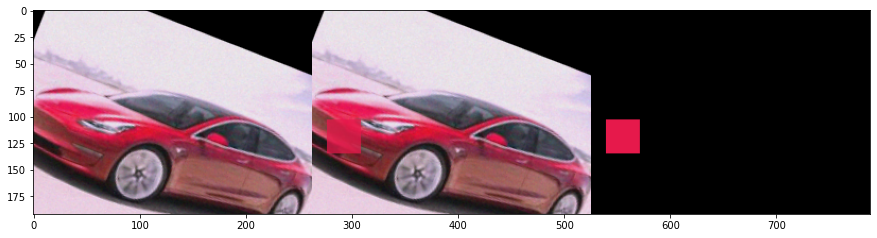

94.49855
114.94716


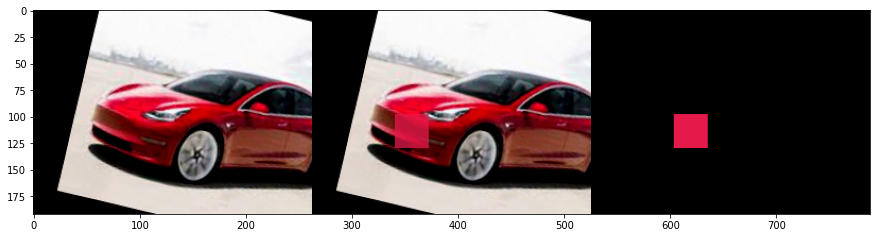

77.306046
151.13177


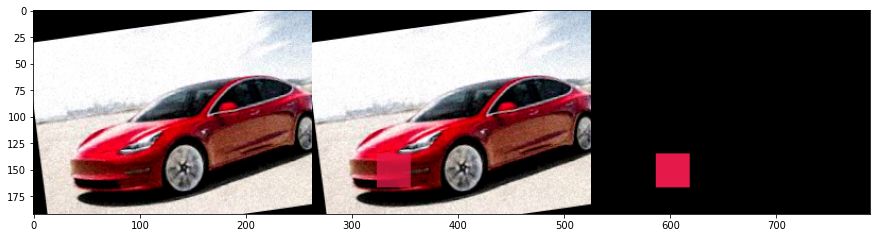

170.86992645263672
129.07745


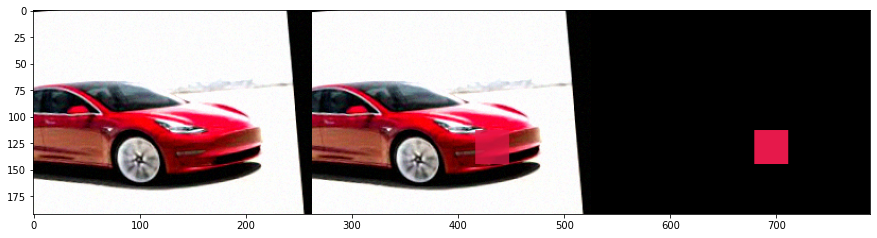

117.48695373535156
158.75583


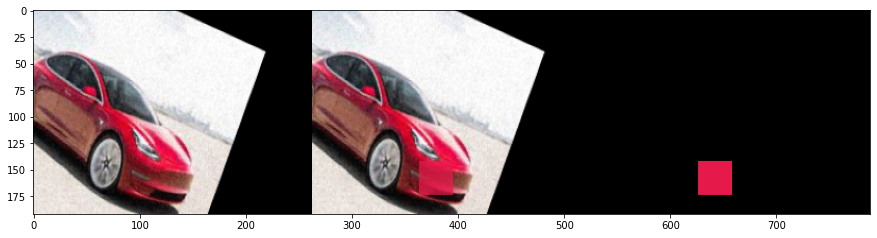

258.9820075035095
103.2108


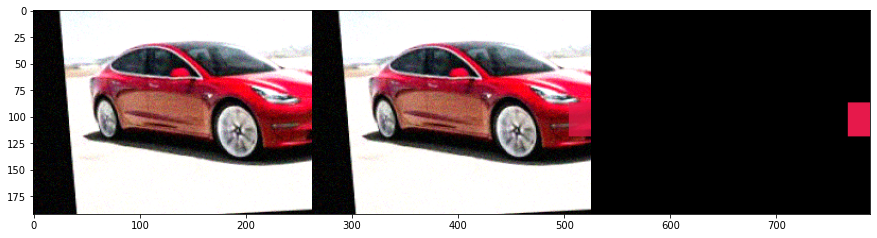

-9.538424
80.022125


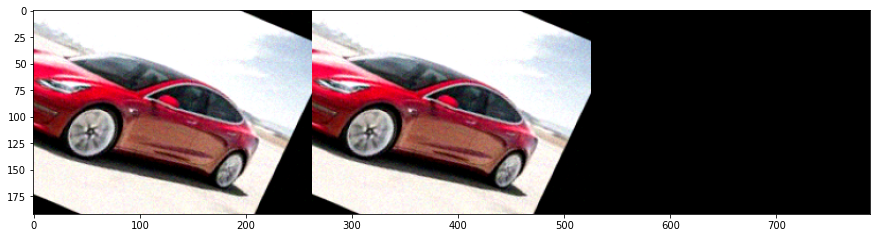

120.14595
98.78409


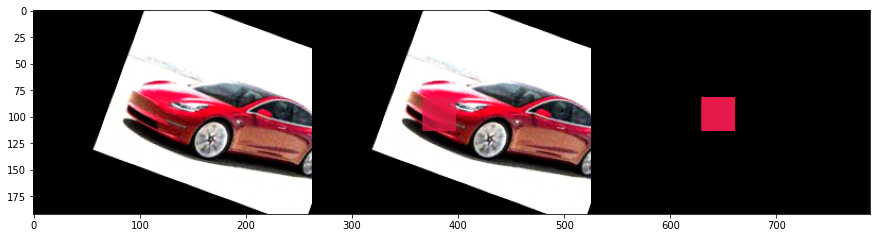

178.5804
107.40809


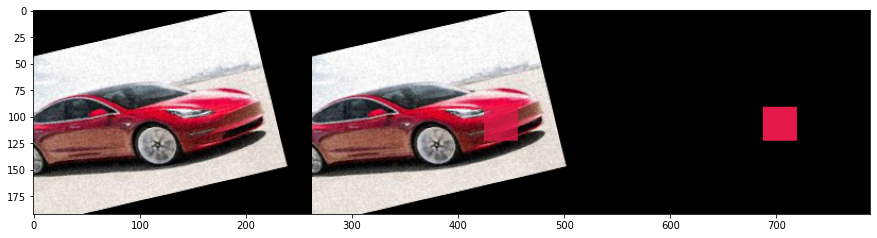

153.05957
138.2467


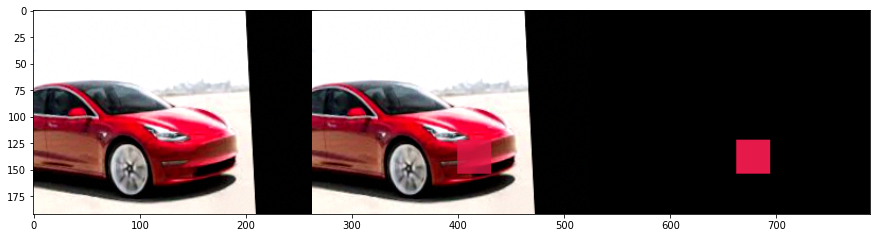

253.36865
113.94232


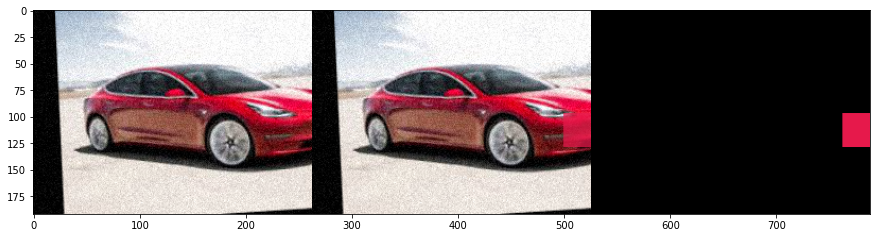

-1.6670036
141.02979


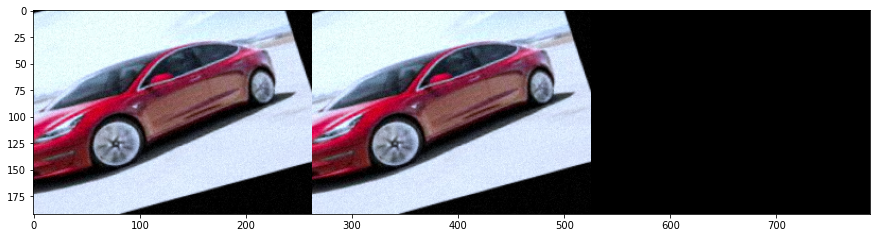

35.884663
109.69862


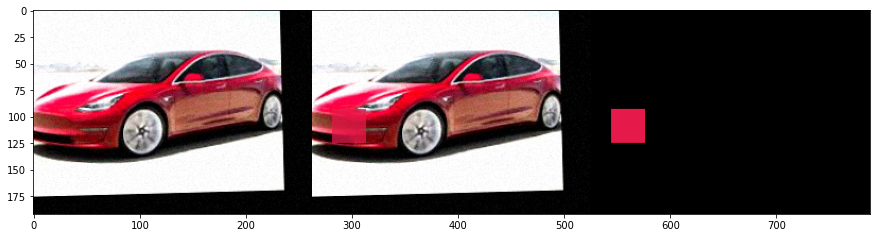

175.98175048828125
146.03218


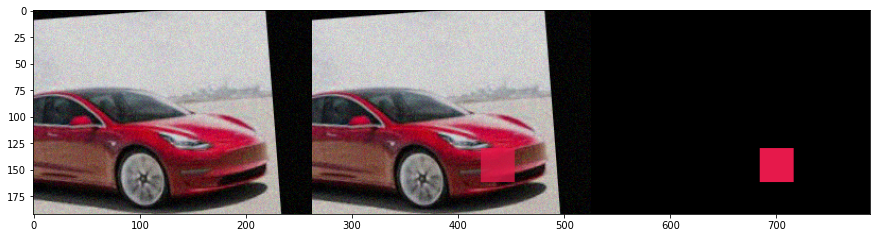

112.84993
117.5074


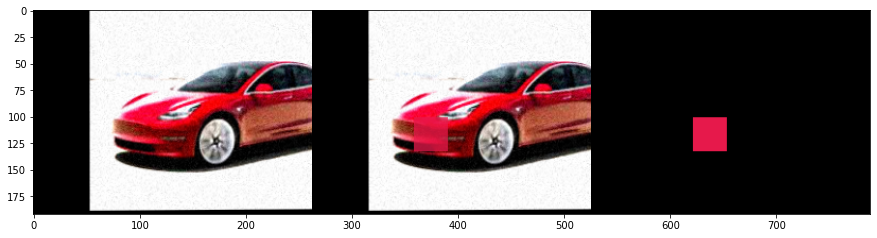

190.6874
177.6339


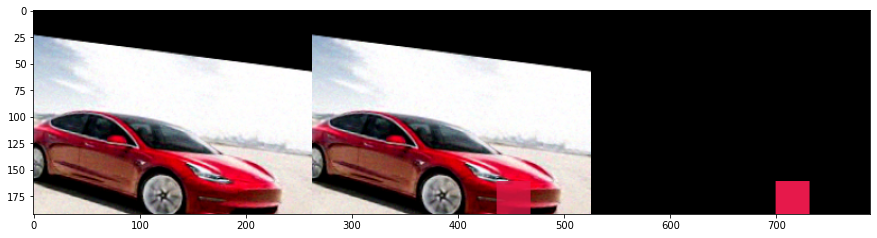

181.49933
111.22087


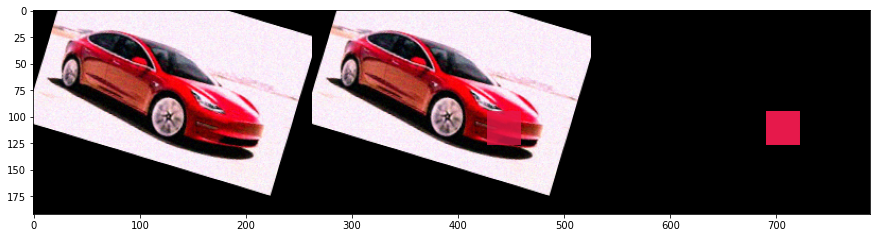

In [151]:
for i in range(20):
    fig,ax = plt.subplots(figsize=(15,8))
    image_aug = pos_images[i]
    x_c = pos_after_xs[i]
    y_c = pos_after_ys[i]
    print(x_c)
    print(y_c)
    segmap = np.zeros((192, 263, 1), dtype=bool)
    segmap[int(y_c)-16:int(y_c)+16, int(x_c)-16:int(x_c)+16,0] = True   #这里可能存在偏差！先y后x
    segmap = SegmentationMapsOnImage(segmap, shape=image_aug.shape)
    print(segmap)
# Draw three columns: (1) original image,
# (2) original image with mask on top, (3) only mask
    cells = [
    image_aug,
    segmap.draw_on_image(image_aug)[0],
    segmap.draw(size=image_aug.shape[:2])[0]]
# Convert cells to a grid image and save.
    grid_image = ia.draw_grid(cells, cols=3)
    #plt.figure(figsize=(15,8))
    plt.imshow(grid_image)
    plt.show()

# <2>Show the negative ones.

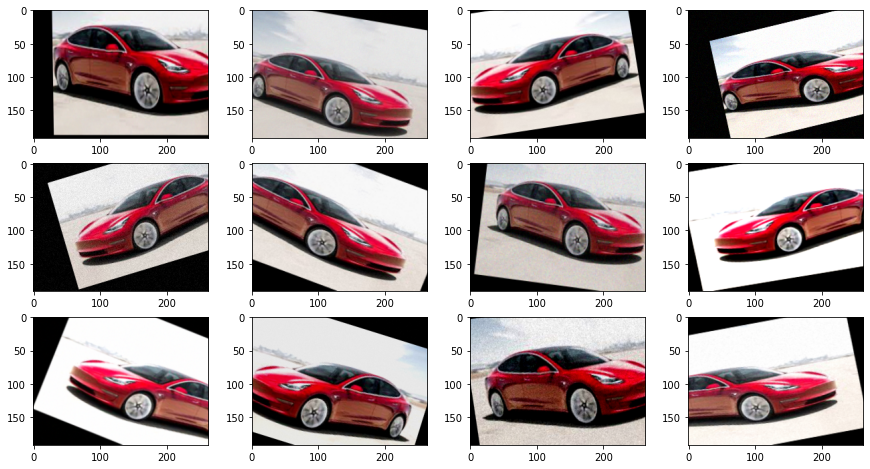

In [165]:
fig = plt.figure(figsize=(15,8))
for i in range(1,13):
    neg_img = neg_images[i-1]
    fig.add_subplot(3,4,i)
    plt.imshow(neg_img)
plt.show()

## Choose the Random Patch for negative ones

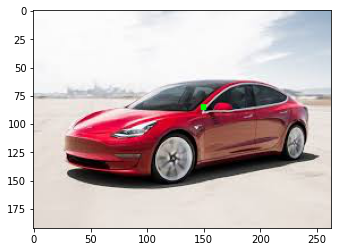

In [170]:
x_r = 150
y_r = 85
kps_rand = [Keypoint(x=x_r,y=y_r)]
kpsoi_rand = KeypointsOnImage(kps_rand,image_color.shape)
kps_rand_img = kpsoi_rand.draw_on_image(image_color,size=5)
plt.imshow(kps_rand_img)
plt.show()
import imgaug.augmenters as iaa
ia.seed(3)

The 0 negative image


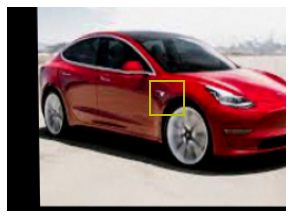

The 1 negative image


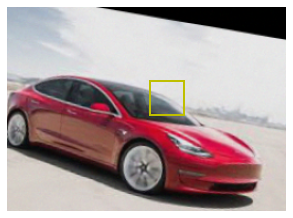

The 2 negative image


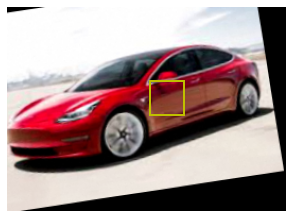

The 3 negative image


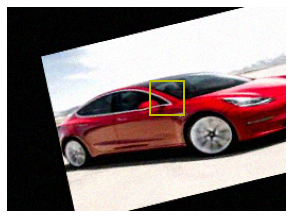

The 4 negative image


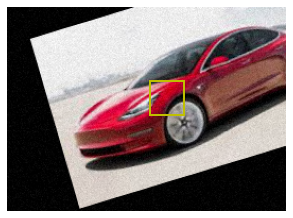

The 5 negative image


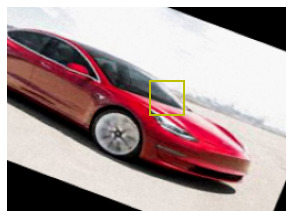

The 6 negative image


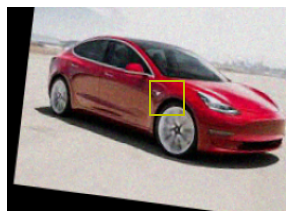

The 7 negative image


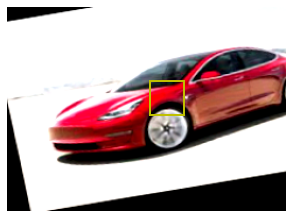

The 8 negative image


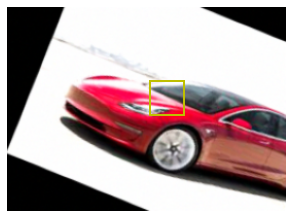

The 9 negative image


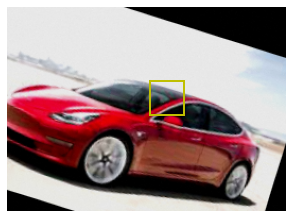

The 10 negative image


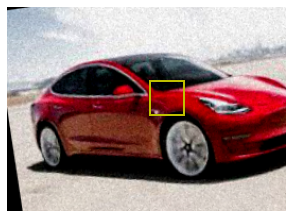

The 11 negative image


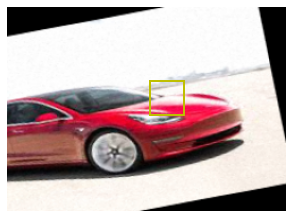

In [171]:
for i in range(12):
    fig,ax = plt.subplots(figsize=(5,8))
    print('The {} negative image'.format(i))
    ax.imshow(neg_images[i])
    aug_neg_pat = ax.add_patch(Rectangle((x_r-16,y_r-16),32,32,fc='none',ec='y',lw=2))
    ax.axis('off')
    plt.show()

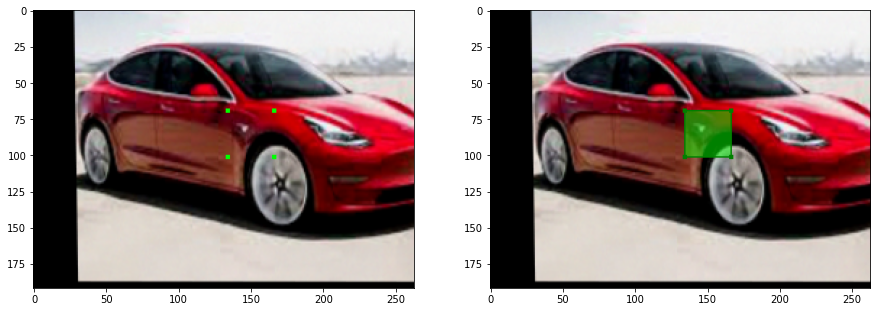

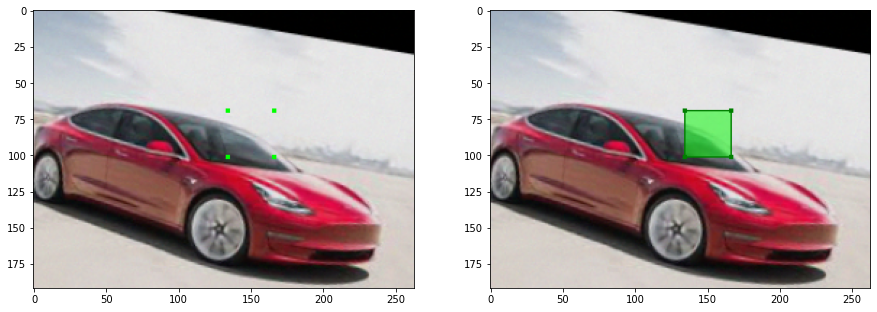

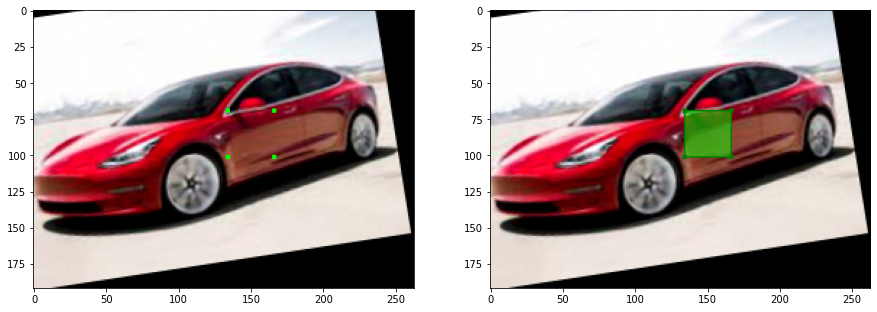

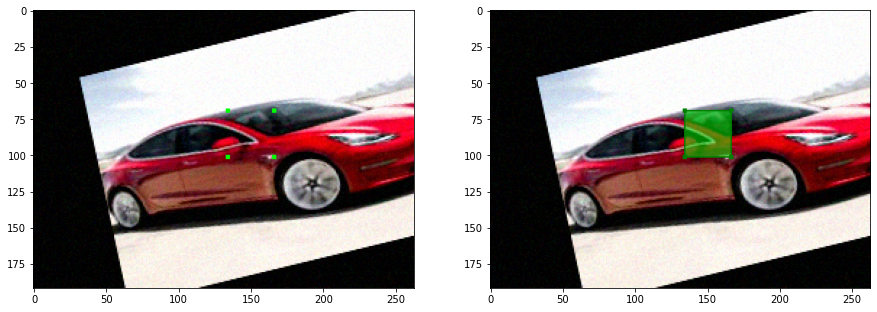

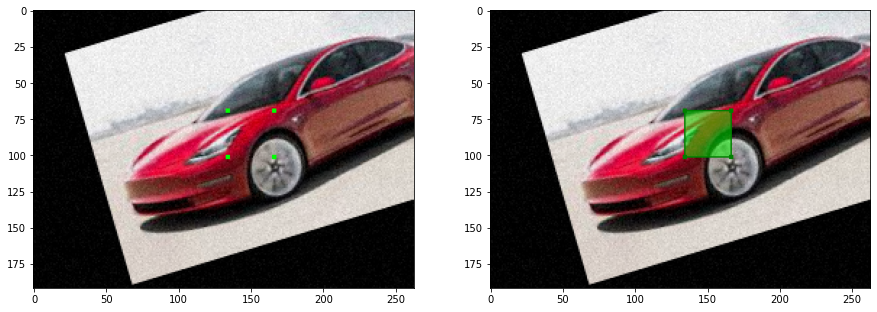

...

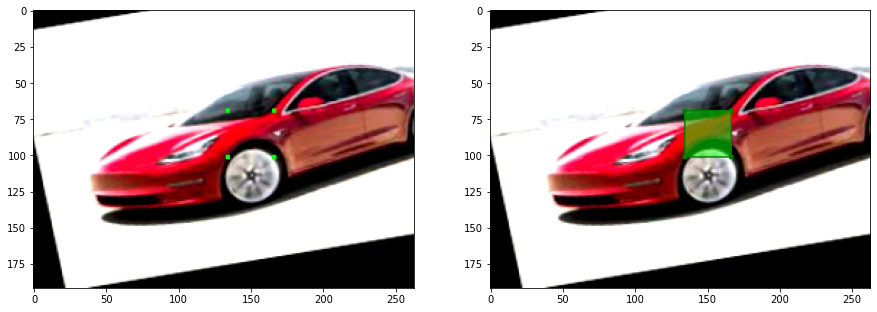

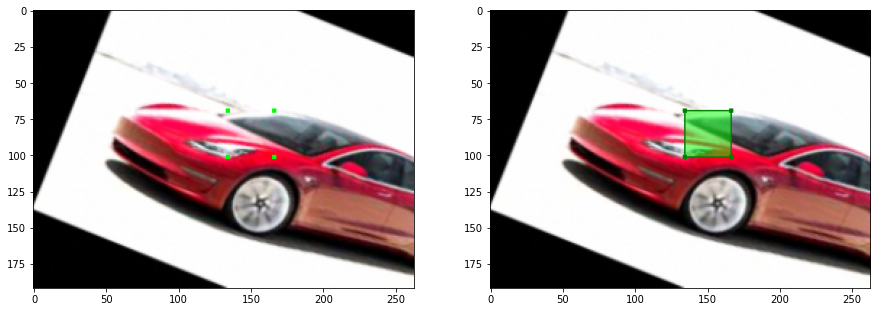

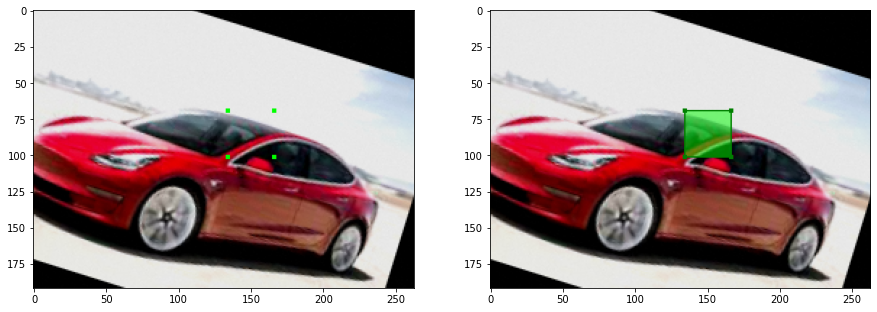

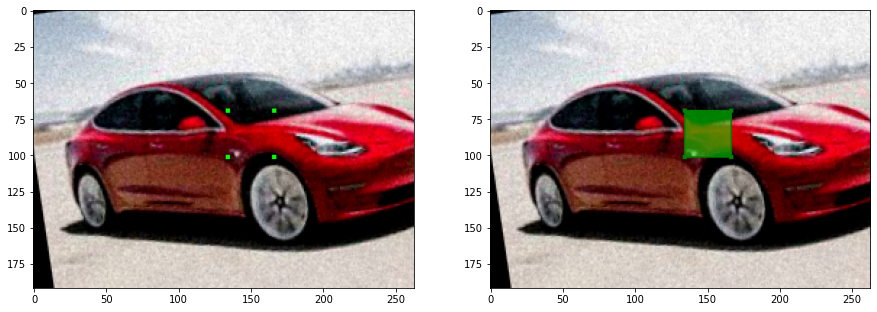

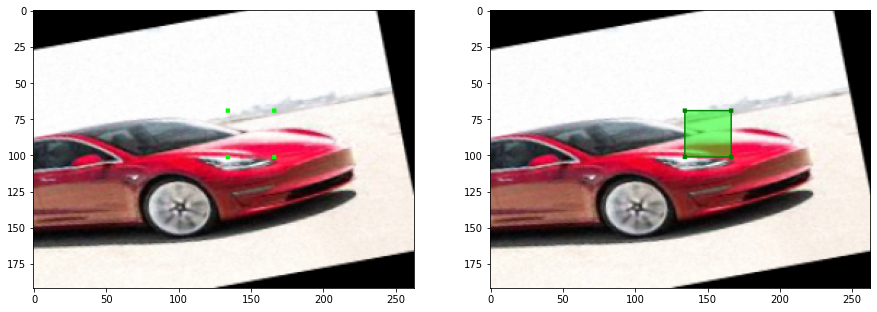

In [172]:
for i in range(12):
    fig,ax = plt.subplots(figsize=(15,8))
    image_aug = neg_images[i]
    chipmunk_kps_xy = np.float32([
    [x_r-16, y_r-16],
    [x_r-16, y_r+16],
    [x_r+16, y_r+16],
    [x_r+16, y_r-16],])
    kpsoi_chipmunk = KeypointsOnImage.from_xy_array(chipmunk_kps_xy, shape=image_aug.shape)
    kpsoi_box_anchor_img = kpsoi_chipmunk.draw_on_image(image_aug, size=3)
#ori_image = imread('car.jpeg', as_gray=False)
    from imgaug.augmentables.polys import Polygon
    poly_chipmunk = Polygon(kpsoi_chipmunk.keypoints)
    poly_img = poly_chipmunk.draw_on_image(image_aug)
    #plt.figure(figsize=(15,8))
    plt.subplot(121)
    plt.imshow(kpsoi_box_anchor_img)
    plt.subplot(122)
    plt.imshow(poly_img)
    plt.show()

In [178]:
def check(image_aug, x_c, y_c):
    height, width, _ = image_aug.shape
    #print(height)
    #print(width)
    if x_c-16<0 or x_c+16>width or y_c-16<0 or y_c+16>height:
        #print('The augmentation patch has been out of range!')
        return 0
    else:
        #print('OKK')
        return 1
j_out = []
for i in range(12):
    image_aug = neg_images[i]
    x_c = x_r
    y_c = y_r
    #print(x_c)
    #print(y_c)
    print('The {} positive image'.format(i))
    check(image_aug, x_c, y_c)
    if check(image_aug, x_c, y_c)!=1:
        print('The augmentation patch has been out of range!')
        j = i
        i_out.append(j)
    else:
        print('OKK')
print('The out of range image indexes')
print(j_out)

The 0 positive image
OKK
The 1 positive image
OKK
The 2 positive image
OKK
The 3 positive image
OKK
The 4 positive image
OKK
The 5 positive image
OKK
The 6 positive image
OKK
The 7 positive image
OKK
The 8 positive image
OKK
The 9 positive image
OKK
The 10 positive image
OKK
The 11 positive image
OKK
The out of range image indexes
[]


## <3> Show the final results and pairs

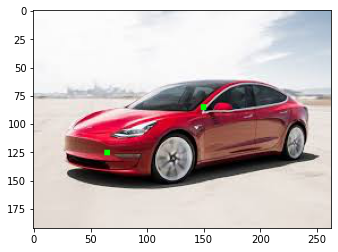

In [204]:
x_a = 65
y_a = 125
x_r = 150
y_r = 85
kps_whole = [Keypoint(x=x_a,y=y_a),
            Keypoint(x=x_r,y=y_r)]
kpsoi_whole = KeypointsOnImage(kps_whole,image_color.shape)
kps_whole_img = kpsoi_whole.draw_on_image(image_color,size=5)
plt.imshow(kps_whole_img)
plt.show()

In [208]:
from torchvision import transforms as T
def tensorify(img):
    res = T.ToTensor()(img)
    res = T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))(res)
    return res

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16
8
175.98175048828125
146.03218
The positive original image with patch and mask


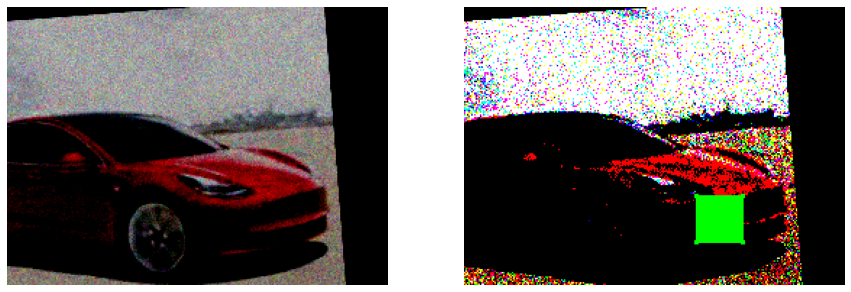

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The negative original image with patch and mask


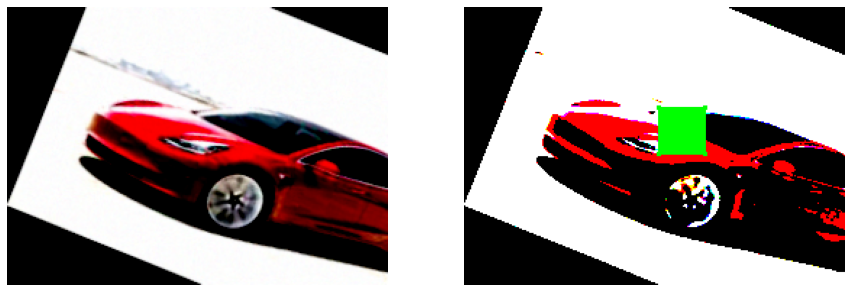

In [209]:
pos_idx = random.sample(range(20),1)
neg_idx = random.sample(range(12),1)
print(pos_idx[0])
print(neg_idx[0])
pos_img = pos_images[pos_idx[0]]
neg_img = neg_images[neg_idx[0]]
pos_x_c = pos_after_xs[pos_idx[0]]
pos_y_c = pos_after_ys[pos_idx[0]]
print(pos_x_c)
print(pos_y_c)
pos_img = tensorify(pos_img)
pos_img = pos_img.numpy()
pos_img = np.transpose(pos_img,(1,2,0))
neg_img = tensorify(neg_img)
neg_img = neg_img.numpy()
neg_img = np.transpose(neg_img,(1,2,0))
fig,ax = plt.subplots(1,2,figsize=(15,8))
ax[0].imshow(pos_img)
#aug_pos_pat = ax[0].add_patch(Rectangle((pos_x_c-16,pos_y_c-16),32,32,fc='none',ec='y',lw=2))
ax[0].axis('off')
chipmunk_kps_xy_pos = np.float32([
    [pos_x_c-16, pos_y_c-16],
    [pos_x_c-16, pos_y_c+16],
    [pos_x_c+16, pos_y_c+16],
    [pos_x_c+16, pos_y_c-16],])
kpsoi_chipmunk_pos = KeypointsOnImage.from_xy_array(chipmunk_kps_xy_pos, shape=pos_img.shape)
kpsoi_box_pos_img = kpsoi_chipmunk_pos.draw_on_image(pos_img, size=3)    #image with 4 points
from imgaug.augmentables.polys import Polygon
poly_chipmunk_pos = Polygon(kpsoi_chipmunk_pos.keypoints)
poly_img_pos = poly_chipmunk_pos.draw_on_image(pos_img)  
#ax[1].imshow(poly_img_pos)
ax[1].imshow(poly_img_pos)
ax[1].axis('off')
print('The positive original image with patch and mask')
plt.show()
fig,ax = plt.subplots(1,2,figsize=(15,8))
ax[0].imshow(neg_img)
#aug_neg_pat = ax[0].add_patch(Rectangle((x_r-16,y_r-16),32,32,fc='none',ec='y',lw=2))
ax[0].axis('off')
chipmunk_kps_xy_neg = np.float32([
    [x_r-16, y_r-16],
    [x_r-16, y_r+16],
    [x_r+16, y_r+16],
    [x_r+16, y_r-16],])
kpsoi_chipmunk_neg = KeypointsOnImage.from_xy_array(chipmunk_kps_xy_neg, shape=neg_img.shape)
kpsoi_box_neg_img = kpsoi_chipmunk_neg.draw_on_image(neg_img, size=3)    #image with 4 points
from imgaug.augmentables.polys import Polygon
poly_chipmunk_neg = Polygon(kpsoi_chipmunk_neg.keypoints)
poly_img_neg = poly_chipmunk_neg.draw_on_image(neg_img)  
ax[1].imshow(poly_img_neg)
ax[1].axis('off')
print('The negative original image with patch and mask')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(192, 263, 3)


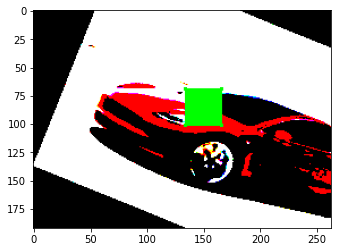

In [210]:
print(pos_img.shape)
plt.imshow(poly_img_neg)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


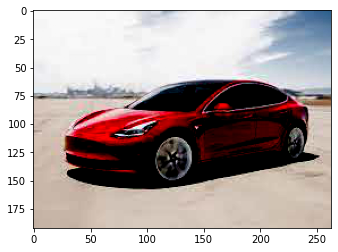

In [211]:
image_color_2 = tensorify(image_color)
image_color_2 = image_color_2.numpy()
image_color_2 = np.transpose(image_color_2,(1,2,0))
plt.imshow(image_color_2)
plt.show()

In [197]:
from torchvision import transforms as T
def tensorify(img):
    #res = T.ToTensor()(img)
    res = T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))(img)
    return res

# Model Architecture

In [212]:
from torchsummary import summary
import torch.nn as nn
import torch.optim as optim
from torchvision.models import resnet18
from collections import OrderedDict
# defining our deep learning architecture
resnet = resnet18(pretrained=True)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
classifier = nn.Sequential(OrderedDict([
    ('fc1', nn.Linear(resnet.fc.in_features, 256)),
    ('added_relu1', nn.ReLU(inplace=True)),
    ('fc2', nn.Linear(256, 64)),
    ('added_relu2', nn.ReLU(inplace=True)),
    ('fc3', nn.Linear(64, 128))
]))

resnet.fc = classifier
resnet.to(device)
summary(resnet, (3, 192, 263))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 64, 96, 132]           9,408
       BatchNorm2d-2          [-1, 64, 96, 132]             128
              ReLU-3          [-1, 64, 96, 132]               0
         MaxPool2d-4           [-1, 64, 48, 66]               0
            Conv2d-5           [-1, 64, 48, 66]          36,864
       BatchNorm2d-6           [-1, 64, 48, 66]             128
              ReLU-7           [-1, 64, 48, 66]               0
            Conv2d-8           [-1, 64, 48, 66]          36,864
       BatchNorm2d-9           [-1, 64, 48, 66]             128
             ReLU-10           [-1, 64, 48, 66]               0
       BasicBlock-11           [-1, 64, 48, 66]               0
           Conv2d-12           [-1, 64, 48, 66]          36,864
      BatchNorm2d-13           [-1, 64, 48, 66]             128
             ReLU-14           [-1, 64,

In [213]:
class EmbedConv(nn.Module):
    def __init__(self):
        super(EmbedConv,self).__init__()
        self.extractor = resnet  #resnet18
     
    def forward(self,a,b):
        x1 = resnet(a)   # 128 D
        x2 = resnet(b)   # 128 D
        x = torch.cat((x1,x2),1)
        return x

In [231]:
net = EmbedConv()
print(net)

EmbedConv(
  (extractor): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track

In [224]:
def embedding(a,b):
    x1 = resnet(a)   # 128 D
    x2 = resnet(b)   # 128 D
    x = torch.cat((x1,x2),1)
    return x

In [239]:
pos_idx_2 = random.sample(range(20),1)
neg_idx_2 = random.sample(range(12),1)
print(pos_idx_2[0])
print(neg_idx_2[0])
pos_img_2 = pos_images[pos_idx_2[0]]
neg_img_2 = neg_images[neg_idx_2[0]]
pos_x_c_2 = pos_after_xs[pos_idx_2[0]]
pos_y_c_2 = pos_after_ys[pos_idx_2[0]]
print(pos_x_c_2)
print(pos_y_c_2)
x_r = 150
y_r = 85
#=====================================#
#===========Draw Rectangle============#
#=====================================#
pil_array = np.zeros((192,263));
t_array = np.linspace(0,1,1000);
 
#===Define Location and Size of Rectangle===#
center = (pos_x_c_2,pos_y_c_2);
x_length = 32;
y_length = 32;
 
#===Define X Line===#
x_start = int(center[0] - 0.5*x_length);
x_end = int(center[0] + 0.5*x_length);
x_line = lambda t: x_start + t*(x_end-x_start);
print(x_line)
#===Define Y Line===#
y_start = int(center[1] + 0.5*y_length);
print(y_start)
y_end = int(center[1] - 0.5*y_length);
y_line = lambda t: y_start + t*(y_end-y_start);
 
#===Outline Rectangle===#
for t in t_array:
 
    #===Draw Bottom Line===#
    pil_array[y_start,x_line(t)] = 1.0;
 
    #===Draw Top line===#
    pil_array[y_end,x_line(t)] = 1.0;
 
    #===Draw Right Line===#
    pil_array[y_line(t),x_end] = 1.0;
 
    #===Draw Left Line===#
    pil_array[y_line(t),x_start] = 1.0;
pil_im = Image.fromarray(255*pil_array.astype(np.uint8));
print(pil_im.shape)

16
4
175.98175048828125
146.03218
<function <lambda> at 0x7fdedc6c5268>
162


IndexError: only integers, slices (`:`), ellipsis (`...`), numpy.newaxis (`None`) and integer or boolean arrays are valid indices

10
1
120.14595
98.78409


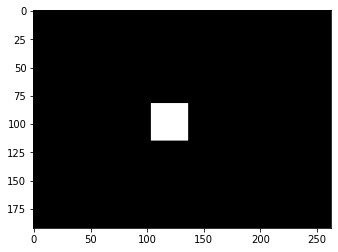

In [249]:
pos_idx_2 = random.sample(range(20),1)
neg_idx_2 = random.sample(range(12),1)
print(pos_idx_2[0])
print(neg_idx_2[0])
pos_img_2 = pos_images[pos_idx_2[0]]
neg_img_2 = neg_images[neg_idx_2[0]]
pos_x_c_2 = pos_after_xs[pos_idx_2[0]]
pos_y_c_2 = pos_after_ys[pos_idx_2[0]]
print(pos_x_c_2)
print(pos_y_c_2)
x_r = 150
y_r = 85
#=====================================#
#===========Draw Rectangle============#
#=====================================#
rect_image = np.zeros((192, 263), np.uint8)
#cv2.rectangle(rect_image,(int(pos_x_c_2),int(pos_y_c_2)),(32,32), 255, -1)
cv2.rectangle(rect_image, (int(pos_x_c_2)-16,int(pos_y_c_2)+16), (int(pos_x_c_2)+16,int(pos_y_c_2)-16), 255, -1)
plt.imshow(rect_image,cmap='gray')
plt.show()

0
2
218.05704
154.90048


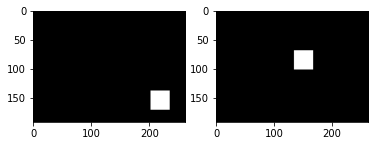

In [252]:
pos_idx_2 = random.sample(range(20),1)
neg_idx_2 = random.sample(range(12),1)
print(pos_idx_2[0])
print(neg_idx_2[0])
pos_img_2 = pos_images[pos_idx_2[0]]
neg_img_2 = neg_images[neg_idx_2[0]]
pos_x_c_2 = pos_after_xs[pos_idx_2[0]]
pos_y_c_2 = pos_after_ys[pos_idx_2[0]]
print(pos_x_c_2)
print(pos_y_c_2)
x_r = 150
y_r = 85
#=====================================#
#===========Draw Rectangle============#
#=====================================#
rect_image = np.zeros((192, 263), np.uint8)
#cv2.rectangle(rect_image,(int(pos_x_c_2),int(pos_y_c_2)),(32,32), 255, -1)
cv2.rectangle(rect_image, (int(pos_x_c_2)-16,int(pos_y_c_2)+16), (int(pos_x_c_2)+16,int(pos_y_c_2)-16), 255, -1)
plt.subplot(121)
plt.imshow(rect_image,cmap='gray')
rect_image_2 = np.zeros((192, 263), np.uint8)
cv2.rectangle(rect_image_2, (int(x_r)-16,int(y_r)+16), (int(x_r)+16,int(y_r)-16), 255, -1)
plt.subplot(122)
plt.imshow(rect_image_2,cmap='gray')
plt.show()

In [253]:
print(rect_image_2.shape)

(192, 263)


## Positive pair image embedding

In [225]:
#x = EmbedConv()
def tensor(img):
    res = T.ToTensor()(img)
    return res
pos_tensor = tensor(pos_img)
pos_tensor = pos_tensor.reshape(1,3,192,263).to(device)
poly_pos_tensor = tensor(poly_img_pos)
poly_pos_tensor = poly_pos_tensor.reshape(1,3,192,263).to(device)
#pos_emb = EmbedConv.forward(_,pos_tensor, poly_pos_tensor)
pos_emb = embedding(pos_tensor, poly_pos_tensor)
print(pos_emb.shape)
print(pos_emb)

torch.Size([1, 256])
tensor([[-0.0364,  0.1425, -0.0921,  0.0082,  0.0271, -0.1446, -0.0268,  0.1626,
         -0.0863, -0.0931,  0.1024,  0.3187, -0.0581,  0.0866, -0.0838,  0.0370,
          0.1268, -0.1171, -0.1346,  0.0399, -0.0607, -0.0226,  0.0355, -0.1138,
         -0.1818, -0.0076,  0.1138, -0.1911,  0.1496, -0.1044, -0.2334,  0.0013,
         -0.1011,  0.2636,  0.1239,  0.0028,  0.1172, -0.0561, -0.2210,  0.1480,
         -0.0622, -0.0519, -0.0859,  0.0469,  0.3290, -0.3492, -0.1956, -0.0841,
         -0.0158, -0.0635,  0.2439,  0.1384,  0.1145,  0.0764,  0.2102, -0.1351,
         -0.0129,  0.0683,  0.0222,  0.0152,  0.0706,  0.2234, -0.0534, -0.0180,
          0.2072,  0.2879,  0.3044,  0.0452,  0.1646, -0.0248, -0.0300,  0.0025,
          0.1999, -0.1838,  0.1965,  0.1817, -0.1482,  0.1146, -0.0500, -0.1029,
         -0.1664, -0.1465, -0.2714, -0.0434, -0.0391, -0.1172,  0.0997, -0.0850,
         -0.0594,  0.0536,  0.0368, -0.2753, -0.0078,  0.0659, -0.0460,  0.0327,
       

## Negative pair image embedding

In [226]:
neg_tensor = tensor(neg_img)
neg_tensor = neg_tensor.reshape(1,3,192,263).to(device)
poly_neg_tensor = tensor(poly_img_neg)
poly_neg_tensor = poly_neg_tensor.reshape(1,3,192,263).to(device)
#neg_emb = EmbedConv.forward(_,neg_tensor, poly_neg_tensor)
neg_emb = embedding(neg_tensor, poly_neg_tensor)
print(neg_emb.shape)
print(neg_emb)

torch.Size([1, 256])
tensor([[-0.0323,  0.1444, -0.0913,  0.0072,  0.0262, -0.1414, -0.0297,  0.1542,
         -0.0830, -0.0894,  0.1020,  0.3286, -0.0602,  0.0902, -0.0794,  0.0344,
          0.1345, -0.1148, -0.1337,  0.0467, -0.0556, -0.0223,  0.0312, -0.1160,
         -0.1716,  0.0009,  0.1156, -0.1877,  0.1532, -0.1016, -0.2431,  0.0066,
         -0.0990,  0.2693,  0.1265,  0.0023,  0.1212, -0.0589, -0.2199,  0.1454,
         -0.0547, -0.0492, -0.0942,  0.0517,  0.3244, -0.3393, -0.1957, -0.0759,
         -0.0185, -0.0644,  0.2444,  0.1367,  0.1104,  0.0782,  0.2063, -0.1360,
         -0.0139,  0.0693,  0.0196,  0.0176,  0.0689,  0.2238, -0.0470, -0.0138,
          0.2060,  0.2799,  0.2957,  0.0395,  0.1639, -0.0224, -0.0241,  0.0020,
          0.1974, -0.1812,  0.1971,  0.1808, -0.1485,  0.1133, -0.0466, -0.1082,
         -0.1641, -0.1449, -0.2776, -0.0423, -0.0458, -0.1212,  0.0965, -0.0813,
         -0.0573,  0.0554,  0.0407, -0.2665, -0.0086,  0.0672, -0.0476,  0.0272,
       

## Original image embedding

In [227]:
ori_tensor = tensor(image_color_2)
ori_tensor = ori_tensor.reshape(1,3,192,263).to(device)
ori_emb = embedding(ori_tensor, ori_tensor)
ori_tensor = tensor(image_color_2)
ori_tensor = ori_tensor.reshape(1,3,192,263).to(device)
ori_emb = embedding(ori_tensor, ori_tensor)
print(ori_emb)

tensor([[-0.0441,  0.1465, -0.0909,  0.0005,  0.0188, -0.1456, -0.0288,  0.1627,
         -0.0834, -0.0835,  0.1026,  0.3175, -0.0489,  0.0868, -0.0817,  0.0260,
          0.1310, -0.1181, -0.1373,  0.0497, -0.0554, -0.0136,  0.0295, -0.1081,
         -0.1766, -0.0057,  0.1119, -0.1993,  0.1485, -0.1037, -0.2383,  0.0024,
         -0.0932,  0.2641,  0.1248,  0.0043,  0.1236, -0.0601, -0.2244,  0.1497,
         -0.0571, -0.0508, -0.0901,  0.0464,  0.3227, -0.3467, -0.1957, -0.0803,
         -0.0199, -0.0618,  0.2385,  0.1380,  0.1093,  0.0808,  0.2077, -0.1428,
         -0.0109,  0.0649,  0.0140,  0.0100,  0.0754,  0.2217, -0.0448, -0.0183,
          0.2031,  0.2838,  0.3039,  0.0448,  0.1585, -0.0186, -0.0271,  0.0101,
          0.1947, -0.1913,  0.1980,  0.1848, -0.1461,  0.1204, -0.0466, -0.1064,
         -0.1661, -0.1440, -0.2755, -0.0440, -0.0442, -0.1200,  0.1025, -0.0806,
         -0.0608,  0.0556,  0.0371, -0.2707, -0.0145,  0.0687, -0.0482,  0.0394,
         -0.0799,  0.0189,  

# NT-Xent Loss

In [228]:
# Code for NT-Xent Loss function, explained in more detail in the article

tau = 0.05

def loss_function(a, b):
    a_norm = torch.norm(a, dim=1).reshape(-1, 1)
    a_cap = torch.div(a, a_norm)
    b_norm = torch.norm(b, dim=1).reshape(-1, 1)
    b_cap = torch.div(b, b_norm)
    a_cap_b_cap = torch.cat([a_cap, b_cap], dim=0)
    a_cap_b_cap_transpose = torch.t(a_cap_b_cap)
    b_cap_a_cap = torch.cat([b_cap, a_cap], dim=0)
    sim = torch.mm(a_cap_b_cap, a_cap_b_cap_transpose)
    sim_by_tau = torch.div(sim, tau)
    exp_sim_by_tau = torch.exp(sim_by_tau)
    sum_of_rows = torch.sum(exp_sim_by_tau, dim=1)
    exp_sim_by_tau_diag = torch.diag(exp_sim_by_tau)
    numerators = torch.exp(torch.div(torch.nn.CosineSimilarity()(a_cap_b_cap, b_cap_a_cap), tau))
    denominators = sum_of_rows - exp_sim_by_tau_diag
    num_by_den = torch.div(numerators, denominators)
    neglog_num_by_den = -torch.log(num_by_den)
    return torch.mean(neglog_num_by_den)

In [230]:
NT_loss_anc_pos = loss_function(ori_emb, pos_emb)
NT_loss_anc_neg = loss_function(ori_emb, neg_emb)
NT_loss_pos_neg = loss_function(pos_emb, neg_emb)
print('NT_loss between anchor & positive')
print(NT_loss_anc_pos)
print('NT_loss between anchor & negative')
print(NT_loss_anc_neg)
#print('NT_loss between positive & negative')
#print(NT_loss_pos_neg)

NT_loss between anchor & positive
tensor(1.9670e-06, device='cuda:0', grad_fn=<MeanBackward0>)
NT_loss between anchor & negative
tensor(3.7849e-06, device='cuda:0', grad_fn=<MeanBackward0>)


# The whole training pipeline

In [232]:
from imgaug.augmentables.polys import Polygon
def create_pair(pos_images, neg_images, pos_after_xs, pos_after_ys):
    pos_idx = random.sample(range(20),1)
    neg_idx = random.sample(range(12),1)
    pos_img = pos_images[pos_idx[0]]
    neg_img = neg_images[neg_idx[0]]
    pos_x_c = pos_after_xs[pos_idx[0]]
    pos_y_c = pos_after_ys[pos_idx[0]]
    pos_img = tensorify(pos_img)
    pos_img = pos_img.numpy()
    pos_img = np.transpose(pos_img,(1,2,0))
    neg_img = tensorify(neg_img)
    neg_img = neg_img.numpy()
    neg_img = np.transpose(neg_img,(1,2,0))
    fig,ax = plt.subplots(1,2,figsize=(15,8))
    ax[0].imshow(pos_img)
    #aug_pos_pat = ax[0].add_patch(Rectangle((pos_x_c-16,pos_y_c-16),32,32,fc='none',ec='y',lw=2))
    ax[0].axis('off')
    chipmunk_kps_xy_pos = np.float32([
           [pos_x_c-16, pos_y_c-16],
           [pos_x_c-16, pos_y_c+16],
           [pos_x_c+16, pos_y_c+16],
           [pos_x_c+16, pos_y_c-16],])
    kpsoi_chipmunk_pos = KeypointsOnImage.from_xy_array(chipmunk_kps_xy_pos, shape=pos_img.shape)
    kpsoi_box_pos_img = kpsoi_chipmunk_pos.draw_on_image(pos_img, size=3)    #image with 4 points
    poly_chipmunk_pos = Polygon(kpsoi_chipmunk_pos.keypoints)
    poly_img_pos = poly_chipmunk_pos.draw_on_image(pos_img)  
    ax[1].imshow(poly_img_pos)
    ax[1].axis('off')
    print('The positive original image with patch and mask')
    plt.show()
    x_r = 150
    y_r = 85
    fig,ax = plt.subplots(1,2,figsize=(15,8))
    ax[0].imshow(neg_img)
    #aug_neg_pat = ax[0].add_patch(Rectangle((x_r-16,y_r-16),32,32,fc='none',ec='y',lw=2))
    ax[0].axis('off')
    chipmunk_kps_xy_neg = np.float32([
           [x_r-16, y_r-16],
           [x_r-16, y_r+16],
           [x_r+16, y_r+16],
           [x_r+16, y_r-16],])
    kpsoi_chipmunk_neg = KeypointsOnImage.from_xy_array(chipmunk_kps_xy_neg, shape=neg_img.shape)
    kpsoi_box_neg_img = kpsoi_chipmunk_neg.draw_on_image(neg_img, size=3)    #image with 4 points
    poly_chipmunk_neg = Polygon(kpsoi_chipmunk_neg.keypoints)
    poly_img_neg = poly_chipmunk_neg.draw_on_image(neg_img)  
    ax[1].imshow(poly_img_neg)
    ax[1].axis('off')
    print('The negative original image with patch and mask')
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The positive original image with patch and mask


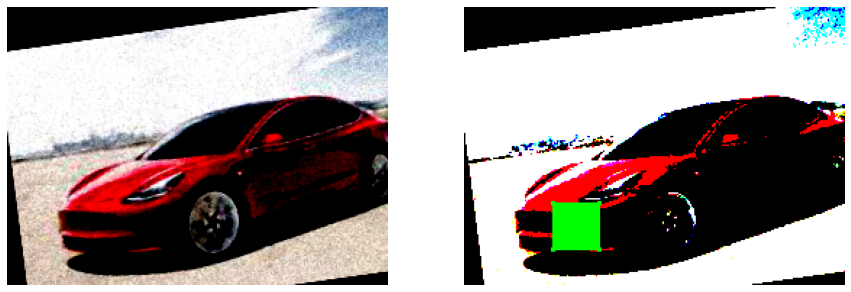

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


The negative original image with patch and mask


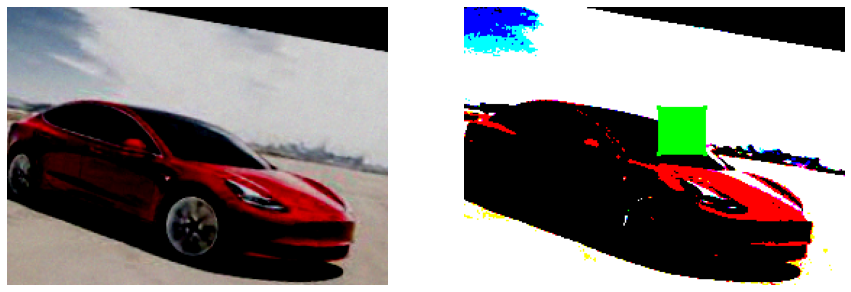

In [233]:
create_pair(pos_images, neg_images, pos_after_xs, pos_after_ys)

In [ ]:
from torch.utils.data import Dataset
class MyDataset(Dataset):
    def __init__(self):
        self.pos_images = pos_images
        self.neg_images = 
        self.pos_idx = random.sample(range(20),1)
        self.neg_idx = random.sample(range(12),1)
        self.embedding = embedding
    def __getitem__(self)
    
    

## Tensorify after the mask.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


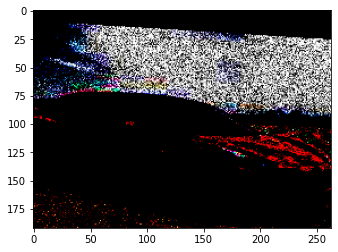

In [202]:
pos_img = tensorify(pos_img)
poly_img_pos = tensorify(poly_img_pos)
neg_img = tensorify(neg_img)
poly_img_neg = tensorify(poly_img_neg)
poly_img_pos_2 = poly_img_pos.numpy()
poly_img_pos_2 = np.transpose(poly_img_pos,(1,2,0))
plt.imshow(poly_img_pos_2)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


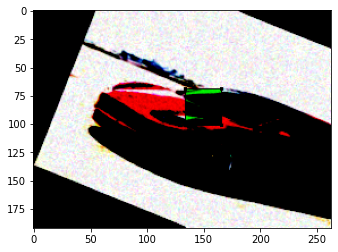

In [203]:
poly_img_neg_2 = poly_img_neg.numpy()
poly_img_neg_2 = np.transpose(poly_img_neg,(1,2,0))
plt.imshow(poly_img_neg_2)
plt.show()

# Model Architecture

In [187]:
import torch
from torchsummary import summary
import torch.nn as nn
import torch.optim as optim
from torchvision.models import resnet18
from collections import OrderedDict
# defining our deep learning architecture
resnet = resnet18(pretrained=True)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
classifier = nn.Sequential(OrderedDict([
    ('fc1', nn.Linear(resnet.fc.in_features, 256)),
    ('added_relu1', nn.ReLU(inplace=True)),
    ('fc2', nn.Linear(256, 64)),
    ('added_relu2', nn.ReLU(inplace=True)),
    ('fc3', nn.Linear(64, 128))
]))

resnet.fc = classifier
resnet.to(device)
summary(resnet, (3, 192, 263))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1          [-1, 64, 96, 132]           9,408
       BatchNorm2d-2          [-1, 64, 96, 132]             128
              ReLU-3          [-1, 64, 96, 132]               0
         MaxPool2d-4           [-1, 64, 48, 66]               0
            Conv2d-5           [-1, 64, 48, 66]          36,864
       BatchNorm2d-6           [-1, 64, 48, 66]             128
              ReLU-7           [-1, 64, 48, 66]               0
            Conv2d-8           [-1, 64, 48, 66]          36,864
       BatchNorm2d-9           [-1, 64, 48, 66]             128
             ReLU-10           [-1, 64, 48, 66]               0
       BasicBlock-11           [-1, 64, 48, 66]               0
           Conv2d-12           [-1, 64, 48, 66]          36,864
      BatchNorm2d-13           [-1, 64, 48, 66]             128
             ReLU-14           [-1, 64,

# Previous operations for one image.

Rectangle(xy=(69, 119), width=32, height=32, angle=0)
Rectangle(xy=(99.6995, 124.928), width=32, height=32, angle=0)


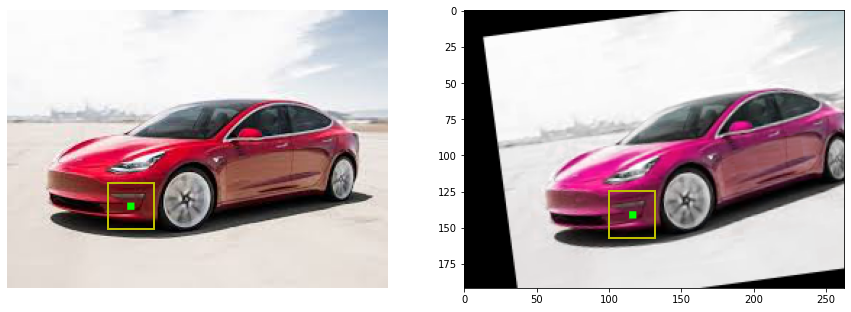

In [67]:
fig,ax = plt.subplots(nrows=1,ncols=3,figsize=(15,8))
ax[0].imshow(kps_anchor_img)
ori_pat = ax[0].add_patch(Rectangle((x_a-16,y_a-16),32,32,fc='none',ec='y',lw=2))
print(ori_pat)
ax[0].axis('off')
ax[1].imshow(kps_anchor_aug_img)
aug_pos_pat = ax[1].add_patch(Rectangle((after_x-16,after_y-16),32,32,fc='none',ec='y',lw=2))
print(aug_pos_pat)
ax[1].axis('off')

plt.show()

# Two ways to draw the masks

## 1. Polygon

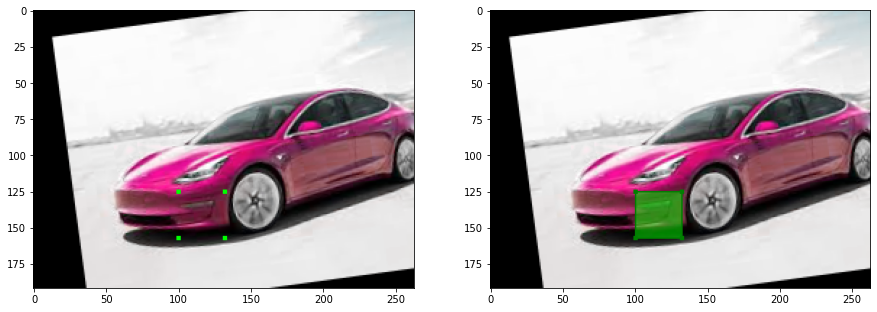

In [84]:
chipmunk_kps_xy = np.float32([
    [after_x-16, after_y-16],
    [after_x-16, after_y+16],
    [after_x+16, after_y+16],
    [after_x+16, after_y-16],
])
kpsoi_chipmunk = KeypointsOnImage.from_xy_array(chipmunk_kps_xy, shape=image_aug.shape)
kpsoi_box_anchor_img = kpsoi_chipmunk.draw_on_image(image_aug, size=3)
#ori_image = imread('car.jpeg', as_gray=False)
from imgaug.augmentables.polys import Polygon
poly_chipmunk = Polygon(kpsoi_chipmunk.keypoints)
poly_img = poly_chipmunk.draw_on_image(image_aug)

plt.figure(figsize=(15,8))
plt.subplot(121)
plt.imshow(kpsoi_box_anchor_img)
plt.subplot(122)
plt.imshow(poly_img)
plt.show()

## Mask in imgaug

In [105]:
print(after_y)
print(after_x)

140.92847
115.699486


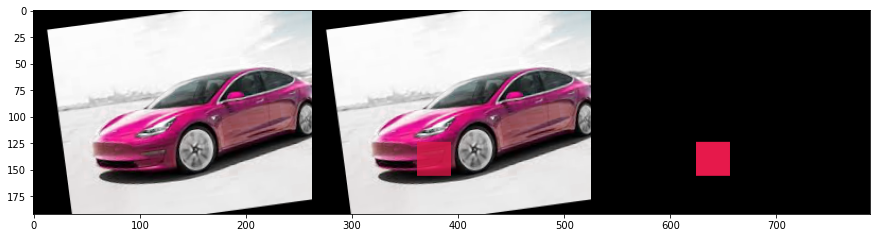

In [107]:
import imageio
import numpy as np
import imgaug as ia
from imgaug.augmentables.segmaps import SegmentationMapsOnImage

# Create an example mask (bool, 128x128).
# Here, we arbitrarily place a square on the image.
segmap = np.zeros((192, 263, 1), dtype=bool)
segmap[int(after_y)-16:int(after_y)+16, int(after_x)-16:int(after_x)+16,0] = True   #这里可能存在偏差！先y后x
segmap = SegmentationMapsOnImage(segmap, shape=image_aug.shape)
print(segmap)
# Draw three columns: (1) original image,
# (2) original image with mask on top, (3) only mask
cells = [
    image_aug,
    segmap.draw_on_image(image_aug)[0],
    segmap.draw(size=image_aug.shape[:2])[0]
]

# Convert cells to a grid image and save.
grid_image = ia.draw_grid(cells, cols=3)
plt.figure(figsize=(15,8))
plt.imshow(grid_image)
plt.show()

# draw the mask

Rectangle(xy=(49, 109), width=32, height=32, angle=0)
Rectangle(xy=(49, 109), width=32, height=32, angle=0)


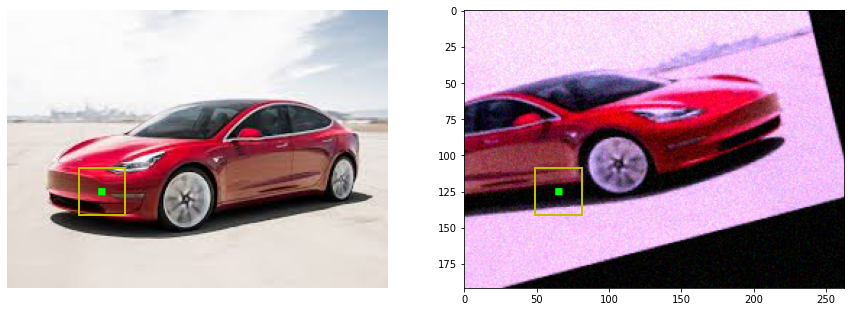

In [39]:
fig,ax = plt.subplots(nrows=1,ncols=2,figsize=(15,8))
ori_img = imread('car.jpeg', as_gray=False)
kps0 = KeypointsOnImage([Keypoint(x=x_a,y=y_a)],shape=ori_img.shape)
kps0_img = kps.draw_on_image(ori_img,size=5)
#kps0_img_pil = Image.fromarray(kps0_img)
ax[0].imshow(kps0_img)
ori_pat = ax[0].add_patch(Rectangle((x_a-16,y_a-16),32,32,fc='none',ec='y',lw=2))
print(ori_pat)
ax[0].axis('off')

image = pos_images[1]
kps1 = KeypointsOnImage([Keypoint(x=x_a,y=y_a)],shape=image.shape)
kps1_img = kps.draw_on_image(image,size=5)
#kps1_img_pil = Image.fromarray(kps1_img)
ax[1].imshow(kps1_img)
aug_pos_pat = ax[1].add_patch(Rectangle((x_a-16,y_a-16),32,32,fc='none',ec='y',lw=2))
print(aug_pos_pat)
plt.show()

# Keypoints for the image

In [31]:
from imgaug.augmentables import Keypoint, KeypointsOnImage
ia.seed(1)

image = image_color
kps = KeypointsOnImage([
    Keypoint(x=65, y=100),
    Keypoint(x=75, y=150),
    Keypoint(x=100, y=100),
    Keypoint(x=150, y=80)
], shape=image.shape)

seq = iaa.Sequential([
    iaa.Multiply((1.2, 1.5)), # change brightness, doesn't affect keypoints
    iaa.Affine(
        rotate=10,
        scale=(0.5, 0.7)
    ) # rotate by exactly 10deg and scale to 50-70%, affects keypoints
])

# Augment keypoints and images.
image_aug, kps_aug = seq(image=image, keypoints=kps)

# print coordinates before/after augmentation (see below)
# use after.x_int and after.y_int to get rounded integer coordinates
for i in range(len(kps.keypoints)):
    before = kps.keypoints[i]
    after = kps_aug.keypoints[i]
    print("Keypoint %d: (%.8f, %.8f) -> (%.8f, %.8f)" % (
        i, before.x, before.y, after.x, after.y)
    )

# image with keypoints before/after augmentation (shown below)
image_before = kps.draw_on_image(image, size=7)
image_after = kps_aug.draw_on_image(image_aug, size=7)

Keypoint 0: (65.00000000, 100.00000000) -> (87.93141174, 90.99147034)
Keypoint 1: (75.00000000, 150.00000000) -> (88.69876099, 124.54912567)
Keypoint 2: (100.00000000, 100.00000000) -> (110.62158966, 94.99236298)
Keypoint 3: (150.00000000, 80.00000000) -> (145.32235718, 87.74210358)


(192, 263, 3)
(192, 263, 3)


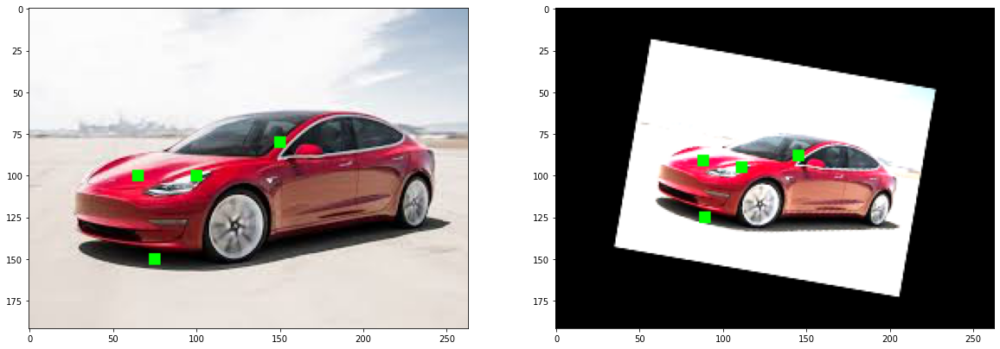

In [32]:
print(image_before.shape)
print(image_after.shape)
plt.figure(figsize=(20,30))
plt.subplot(121)
plt.imshow(image_before)
plt.subplot(122)
plt.imshow(image_after)
plt.show()

Rectangle(xy=(49, 84), width=32, height=32, angle=0)


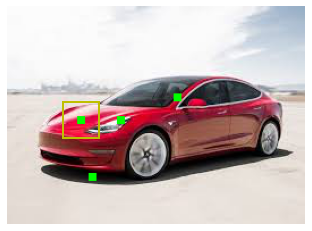

In [37]:
i = 65
j = 100
import matplotlib.patches as patches
from matplotlib.patches import Rectangle
fig, ax = plt.subplots()
im = ax.imshow(image_before)
pat = ax.add_patch(Rectangle((i-16, j-16), 
                        32, 32, 
                        fc ='none',  
                        ec ='y', 
                        lw = 2))
print(pat)
ax.axis('off')
plt.show()